<a href="https://colab.research.google.com/github/Atharva-Gaykar/Deep_Learning/blob/main/notebooks/image_data/GAN_ANIME_FACE.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

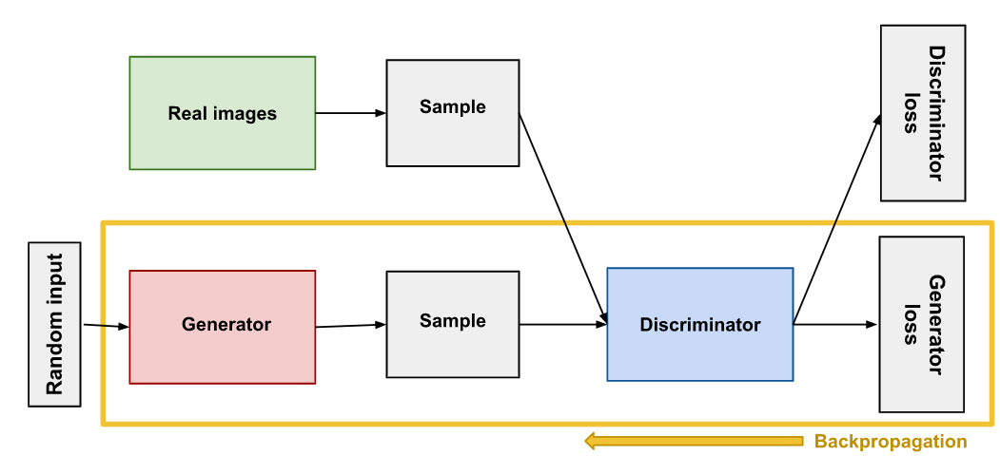




---

## 🎨 Through this project: Anime Face Generation Using DCGAN

* Built a **Deep Convolutional GAN (DCGAN)** to generate **anime-style face images** from random noise vectors.
* Trained the GAN on a dataset of anime faces, using **unsupervised learning** to model the underlying data distribution.

---

### 🧠 What is DCGAN?

* **DCGAN** is a type of GAN that uses **Convolutional Neural Networks (CNNs)** instead of fully connected layers.
* It consists of two networks:

  * **Generator**: learns to produce realistic fake anime faces from random noise (`z`)
  * **Discriminator**: learns to distinguish between real and generated faces

---

### 🛠️ Key Components Implemented:

* **Generator**:

  * Upsampling layers using `Conv2DTranspose`
  * Batch normalization for stable training
  * `ReLU` activations (except last layer uses `tanh`)

* **Discriminator**:

  * Downsampling using `Conv2D`
  * LeakyReLU activations
  * Sigmoid output to classify real vs fake

---

### 🔁 Training Strategy:

* Alternately trained the **discriminator** and **generator**:

  * Discriminator tries to **maximize** ability to classify real vs fake
  * Generator tries to **fool the discriminator**
* Used **Binary Cross Entropy Loss** for both networks
* Optimized with **Adam Optimizer** (with tuned learning rate and betas)
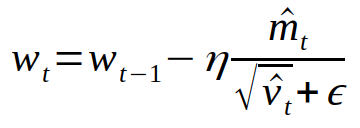

ACTIVATION FUNCTION USED

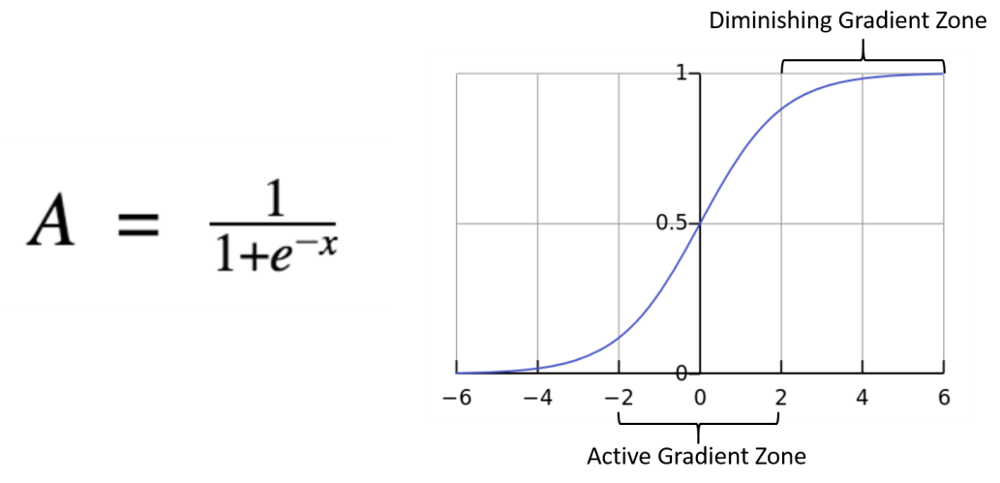

LOSS FUNCTION USED

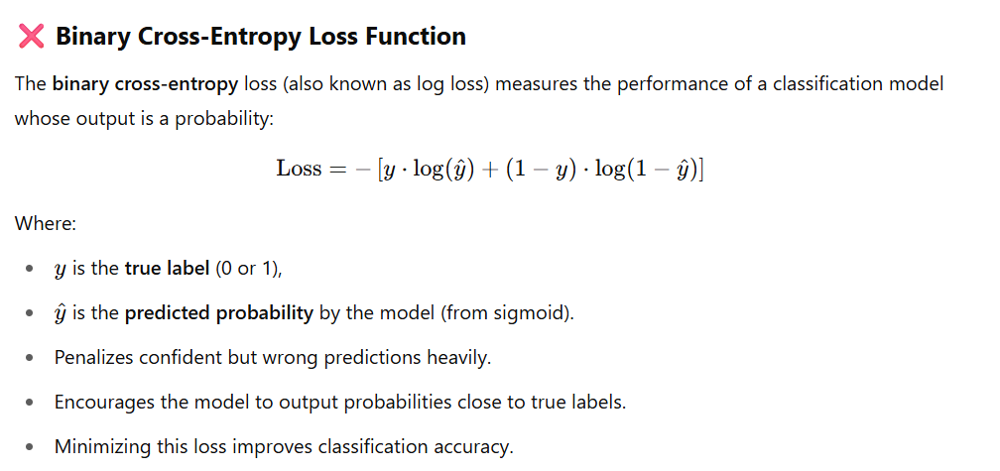

In [ ]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("soumikrakshit/anime-faces")

print("Path to dataset files:", path)

Path to dataset files: /kaggle/input/anime-faces


In [ ]:
work_dir='/kaggle/input/anime-faces'

In [ ]:


import os
import pandas as pd
# Assuming the dataset is in the expected directory structure
image_dir = os.path.join(path, work_dir)
image_paths = []
for root, _, files in os.walk(image_dir):
  for file in files:
    if file.lower().endswith(('.png', '.jpg', '.jpeg')):
      image_paths.append(os.path.join(root, file))
# Create a DataFrame
df = pd.DataFrame({'path': image_paths})



In [ ]:
df

,path
0,/kaggle/input/anime-faces/data/21130.png
1,/kaggle/input/anime-faces/data/9273.png
2,/kaggle/input/anime-faces/data/18966.png
3,/kaggle/input/anime-faces/data/14127.png
4,/kaggle/input/anime-faces/data/18054.png
...,...
43097,/kaggle/input/anime-faces/data/data/12060.png
43098,/kaggle/input/anime-faces/data/data/7013.png
43099,/kaggle/input/anime-faces/data/data/14107.png
43100,/kaggle/input/anime-faces/data/data/16486.png


In [ ]:
df.shape

(43102, 1)

In [ ]:


from IPython.display import Image, display

def display_image_from_dataframe(index):

  if 0 <= index < len(df):
    image_path = df.loc[index, 'path']
    display(Image(filename=image_path))
  else:
    print(f"Index out of bounds. Please provide an index between 0 and {len(df) - 1}.")

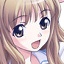

In [ ]:
display_image_from_dataframe(9000)

In [ ]:


def display_image_from_dataframe_doubled_size(index):
  if 0 <= index < len(df):
    image_path = df.loc[index, 'path']
    # Open the image to get its dimensions
    from PIL import Image as PILImage
    pil_img = PILImage.open(image_path)
    original_width, original_height = pil_img.size

    # Double the size
    new_width = original_width * 4
    new_height = original_height * 4

    display(Image(filename=image_path, width=new_width, height=new_height))
  else:
    print(f"Index out of bounds. Please provide an index between 0 and {len(df) - 1}.")



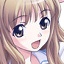

In [ ]:

display_image_from_dataframe_doubled_size(9000)

In [ ]:

import cv2
import numpy as np


In [ ]:
import cv2
import matplotlib.pyplot as plt
import os

import cv2
import numpy as np

def apply_sharpening(image):
    blurred = cv2.GaussianBlur(image, (0, 0), 1)  # Use small sigma for finer control
    sharpened = cv2.addWeighted(image, 1.1, blurred, -0.1, 0)  # Balanced weights
    return sharpened



# Define image display function with doubled size






---

### 🖼️ Image Preprocessing: Light Sharpening Applied

* Applied **light sharpening** to the input anime face images before training the GAN.
* Sharpening enhances **edges and contours**, making facial features more defined.
* Helps the **discriminator** learn fine-grained textures and boundaries more effectively.
* Improved the **clarity and contrast** of features such as eyes, hair strands, and outlines.


---

### 🔍 Why Sharpening Helps in GANs:

* Makes **training images more detailed**, especially in low-resolution datasets.
* Encourages the **generator** to learn **sharper and more realistic outputs**.
* Reduces the chance of overly **blurry outputs**, which is a common issue in early GAN training.

---




Displaying side by side:


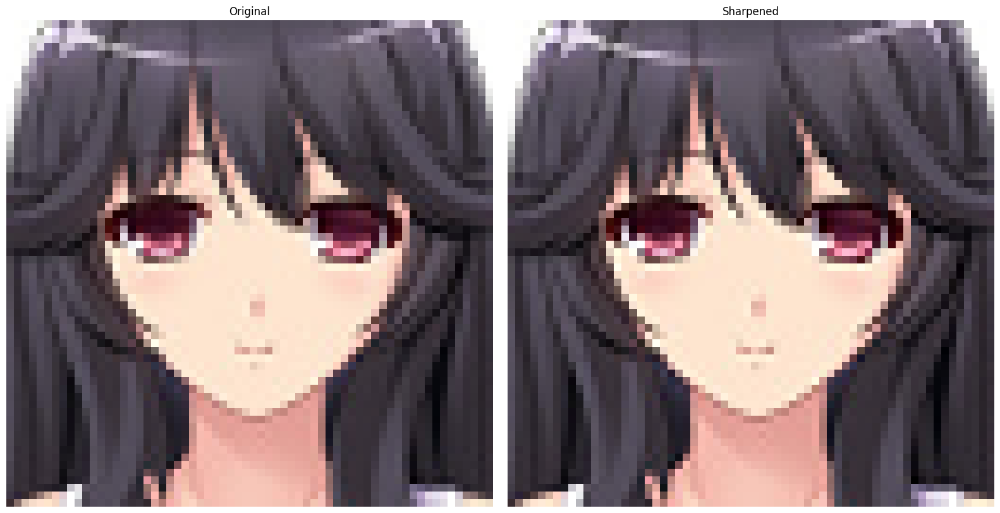

In [ ]:

import matplotlib.pyplot as plt


# Function to display original and sharpened side-by-side with doubled size
def display_side_by_side_doubled(original_bgr, sharpened_bgr, titles=["Original", "Sharpened"]):
    # Convert BGR to RGB
    original_rgb = cv2.cvtColor(original_bgr, cv2.COLOR_BGR2RGB)
    sharpened_rgb = cv2.cvtColor(sharpened_bgr, cv2.COLOR_BGR2RGB)

    # Double size
    h, w = original_rgb.shape[:2]
    original_resized = cv2.resize(original_rgb, (w * 1, h * 1), interpolation=cv2.INTER_LINEAR)
    sharpened_resized = cv2.resize(sharpened_rgb, (w * 1, h * 1), interpolation=cv2.INTER_LINEAR)

    # Plot side by side
    plt.figure(figsize=(16, 8))
    plt.subplot(1, 2, 1)
    plt.imshow(original_resized)
    plt.title(titles[0])
    plt.axis("off")

    plt.subplot(1, 2, 2)
    plt.imshow(sharpened_resized)
    plt.title(titles[1])
    plt.axis("off")

    plt.tight_layout()
    plt.show()

# Main image processing
index_to_process = 10000

if 0 <= index_to_process < len(df):
    image_path = df.loc[index_to_process, 'path']

    # Load the image using OpenCV
    image_bgr = cv2.imread(image_path)

    if image_bgr is not None:
        sharpened_image_bgr = apply_sharpening(image_bgr)

        print("Displaying side by side:")
        display_side_by_side_doubled(image_bgr, sharpened_image_bgr)
    else:
        print(f"Error: Could not load image from {image_path}")
else:
    print(f"Index out of bounds. Please provide an index between 0 and {len(df) - 1}.")


In [ ]:
train_dir = 'train_dir'
class_name = 'celeba'  # or any label

class_path = os.path.join(train_dir, class_name)
os.makedirs(class_path, exist_ok=True)

print(f"Processing and sharpening {len(df)} images...")

for index, row in df.iterrows():
    image_path = row['path']
    image_bgr = cv2.imread(image_path)

    if image_bgr is not None:
        sharpened_image_bgr = apply_sharpening(image_bgr)
        original_filename = os.path.basename(image_path)
        output_path = os.path.join(class_path, original_filename)
        cv2.imwrite(output_path, sharpened_image_bgr)
    else:
        print(f"Warning: Could not load image from {image_path}. Skipping.")

print("Image processing complete.")
print(f"Sharpened images saved to: {class_path}")


Processing and sharpening 43102 images...
Image processing complete.
Sharpened images saved to: train_dir/celeba


In [ ]:
def load_img(path):
  """Loads an image from a file path."""
  from PIL import Image as PILImage # Import PILImage here
  img = PILImage.open(path)
  return img

plt.figure(figsize = (25, 25))

train_image_paths = [os.path.join(train_dir, f) for f in os.listdir(train_dir) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

temp_images = train_image_paths[:24]
index = 1
for i in temp_images:
  plt.subplot(8, 8, index)
  # load the image
  img = load_img(i)

  img = np.array(img)
  plt.imshow(img)
  plt.axis('off')
  index += 1
plt.show()

<Figure size 2500x2500 with 0 Axes>

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision
from tqdm import tqdm
import torchvision.datasets as datasets
from torchvision.datasets import ImageFolder
from torchvision.utils import make_grid
import torchvision.utils as vutils
import torchvision.transforms as transforms
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
from torch.utils.data import Subset
import numpy as np

In [ ]:

image_size = 64
batch_size = 128
latent_dim = 100  # Latent vector size
lr = 0.0002
beta1 = 0.5
epochs = 100


transform = transforms.Compose([
    transforms.Resize(image_size),
    transforms.CenterCrop(image_size),
    transforms.ToTensor(),
    transforms.Normalize([0.5]*3, [0.5]*3)  # Normalize to [-1, 1]
])

In [ ]:
dataset = datasets.ImageFolder(train_dir, transform=transform)
dataloader = DataLoader(dataset=dataset, batch_size=batch_size, shuffle=True)

The key component in upsampling is CONV2D Transpose
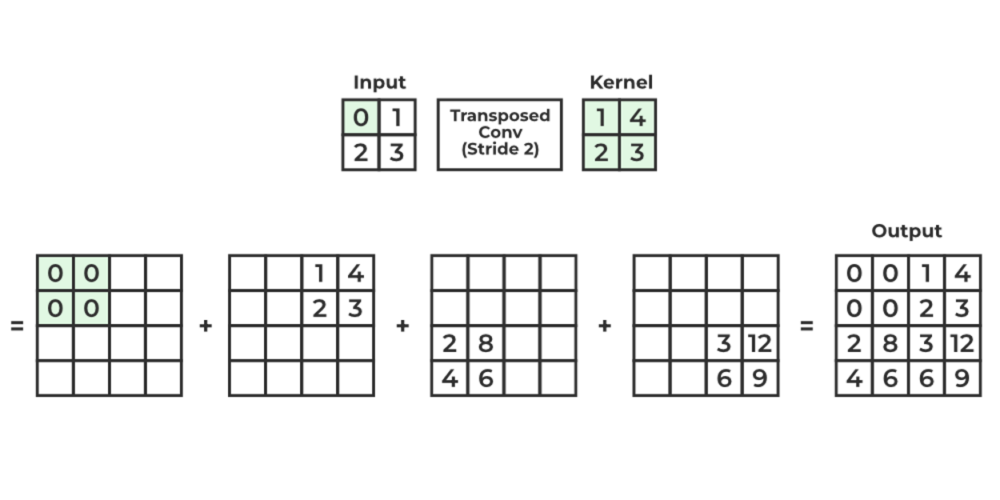

In [ ]:
import torch
import torch.nn as nn

class Generator(nn.Module):
    def __init__(self, latent_dim=100):
        super(Generator, self).__init__()
        self.latent_dim = latent_dim

        self.model = nn.Sequential(
            # Project latent vector to 8x8x512 feature map
            nn.Linear(latent_dim, 8 * 8 * 512),
            nn.BatchNorm1d(8 * 8 * 512),
            nn.LeakyReLU(0.2, inplace=True),

            # Reshape to (512, 8, 8)
            nn.Unflatten(1, (512, 8, 8)),

            # First upsampling: 8x8 → 16x16
            nn.ConvTranspose2d(512, 256, kernel_size=5, stride=2, padding=2, output_padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),

            # Second upsampling: 16x16 → 32x32
            nn.ConvTranspose2d(256, 128, kernel_size=5, stride=2, padding=2, output_padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),

            # Third upsampling: 32x32 → 64x64 → Final output
            nn.ConvTranspose2d(128, 3, kernel_size=5, stride=2, padding=2, output_padding=1, bias=False),
            nn.Tanh()
        )

        # Initialize weights
        self._initialize_weights()

    def _initialize_weights(self):
        for m in self.modules():
            if isinstance(m, (nn.ConvTranspose2d, nn.Linear)):
                nn.init.normal_(m.weight, mean=0.0, std=0.02)
            elif isinstance(m, nn.BatchNorm2d):
                nn.init.normal_(m.weight, mean=1.0, std=0.02)
                nn.init.constant_(m.bias, 0)

    def forward(self, z):
        return self.model(z)

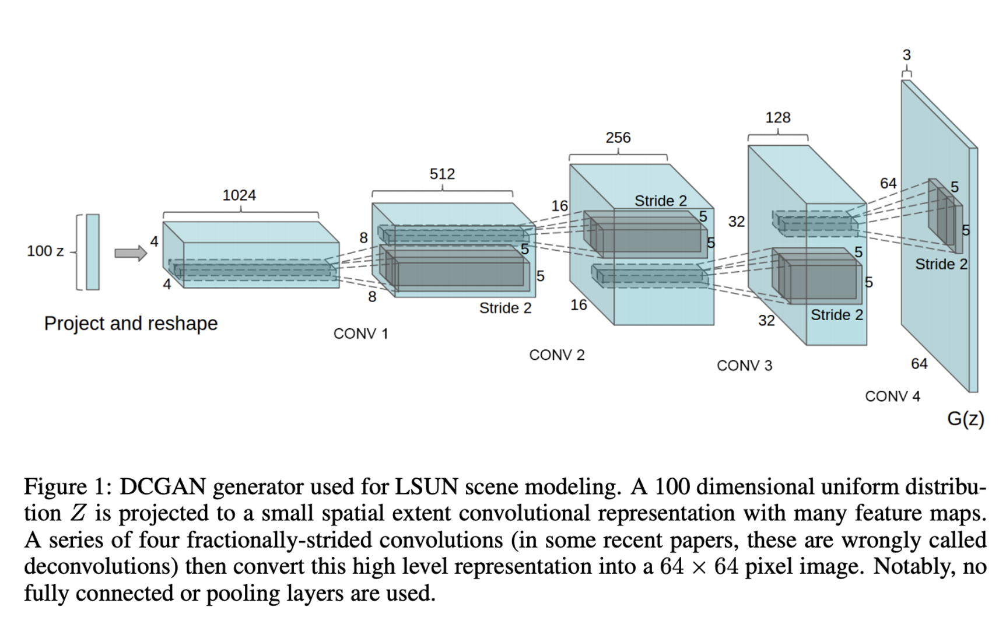

In [ ]:
import torch
import torch.nn as nn

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()

        self.model = nn.Sequential(
            # Input: 3 x 64 x 64
            # Layer 1: No BatchNorm
            nn.Conv2d(3, 64, kernel_size=5, stride=2, padding=2, bias=False),
            nn.LeakyReLU(0.2, inplace=True),

            # Layer 2: 64 x 32 x 32 → 128 x 16 x 16
            nn.Conv2d(64, 128, kernel_size=5, stride=2, padding=2, bias=False),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),

            # Layer 3: 128 x 16 x 16 → 256 x 8 x 8
            nn.Conv2d(128, 256, kernel_size=5, stride=2, padding=2, bias=False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),

            # Layer 4: 256 x 8 x 8 → 512 x 4 x 4
            nn.Conv2d(256, 512, kernel_size=5, stride=2, padding=2, bias=False),
            nn.BatchNorm2d(512),
            nn.PReLU(),

            # Output layer: 512 x 4 x 4 → 1 x 1 x 1
            nn.Conv2d(512, 1, kernel_size=4, stride=1, padding=0, bias=False),
            nn.Sigmoid()
        )

        # Initialize weights
        self._initialize_weights()

    def _initialize_weights(self):
        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                nn.init.normal_(m.weight, mean=0.0, std=0.02)
            elif isinstance(m, nn.BatchNorm2d):
                nn.init.normal_(m.weight, mean=1.0, std=0.02)
                nn.init.constant_(m.bias, 0)

    def forward(self, x):
        # Flatten the output to match Keras version's Dense layer behavior
        return self.model(x).view(-1)

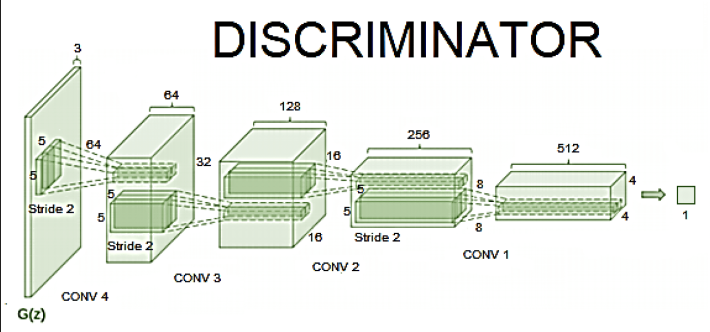



---

### 🔧 Discriminator Tweaks: Used `PReLU()` Instead of `LeakyReLU`

* In the **discriminator network**, I used **`PReLU()`** (Parametric ReLU) instead of `LeakyReLU` in the final convolutional layers.
* Unlike `LeakyReLU(α=0.01)`, which uses a fixed negative slope, `PReLU` allows the **slope of the negative side to be learned** during training:

#### 📌 Formula:

$$
f(x) =
\begin{cases}
x, & \text{if } x > 0 \\
a \cdot x, & \text{if } x \leq 0 \quad \text{(where } a \text{ is trainable)}
\end{cases}
$$

---

### 🧠 Why I Used `PReLU`:

* Gives the model **flexibility** to learn the best negative slope instead of setting it manually.
* Can lead to **better convergence** and **smoother gradient flow**, especially in deeper or more sensitive discriminator layers.
* Aims to enhance **feature sensitivity** and **adaptability** during training.

---

✅ This adjustment contributed to more **stable GAN training** and improved the **discriminator's ability to capture subtle differences** between real and generated images.

---



In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision.utils import save_image
import os

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using device:", device)

# Instantiate models
generator = Generator(latent_dim).to(device)
discriminator = Discriminator().to(device)

# Loss function
criterion = nn.BCELoss()

# Optimizers
optimizer_G = optim.Adam(generator.parameters(), lr=lr, betas=(beta1, 0.999))
optimizer_D = optim.Adam(discriminator.parameters(), lr=lr, betas=(beta1, 0.999))

# For saving generated images
os.makedirs("generated_images", exist_ok=True)

Using device: cuda


In [ ]:
def visualize_generated_images(generator, fixed_noise, epoch, num_imgs=5):
    generator.eval()
    with torch.no_grad():
        fake_images = generator(fixed_noise).detach().cpu()
        fake_images = fake_images * 0.5 + 0.5  # Unnormalize from [-1, 1] to [0, 1]

    grid = make_grid(fake_images[:num_imgs], nrow=num_imgs, normalize=False)
    np_grid = grid.permute(1, 2, 0).numpy()  # C x H x W -> H x W x C

    plt.figure(figsize=(num_imgs * 2, 2))
    plt.imshow(np_grid)
    plt.axis('off')
    plt.title(f"Generated Samples at Epoch {epoch + 1}")
    plt.show()


Epoch [1/100] Batch [0/169] Loss D: 1.6749, Loss G: 0.9758
Epoch [1/100] Batch [50/169] Loss D: 1.8729, Loss G: 4.9819
Epoch [1/100] Batch [100/169] Loss D: 1.2509, Loss G: 1.7352
Epoch [1/100] Batch [150/169] Loss D: 1.1636, Loss G: 3.3370


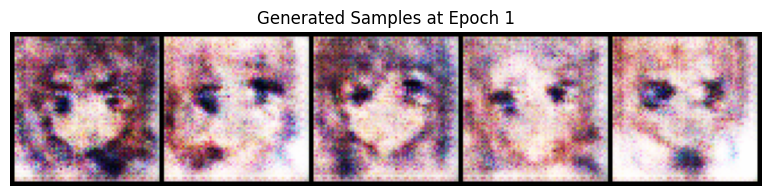

Epoch [2/100] Batch [0/169] Loss D: 0.8699, Loss G: 3.0809
Epoch [2/100] Batch [50/169] Loss D: 0.6996, Loss G: 2.7498
Epoch [2/100] Batch [100/169] Loss D: 0.6713, Loss G: 2.7142
Epoch [2/100] Batch [150/169] Loss D: 1.8716, Loss G: 6.0315


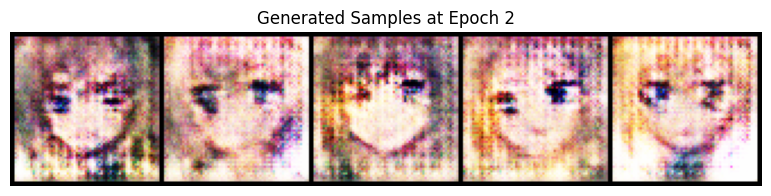

Epoch [3/100] Batch [0/169] Loss D: 0.8177, Loss G: 6.6483
Epoch [3/100] Batch [50/169] Loss D: 0.3785, Loss G: 4.4199
Epoch [3/100] Batch [100/169] Loss D: 0.4802, Loss G: 2.5544
Epoch [3/100] Batch [150/169] Loss D: 1.1298, Loss G: 5.1589


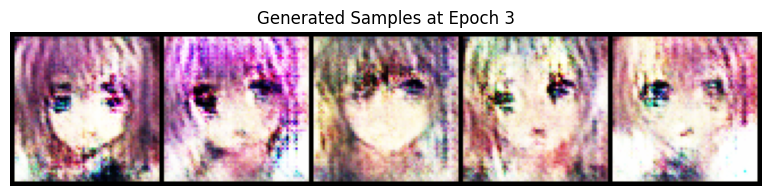

Epoch [4/100] Batch [0/169] Loss D: 1.2618, Loss G: 3.3914
Epoch [4/100] Batch [50/169] Loss D: 1.7184, Loss G: 6.0019
Epoch [4/100] Batch [100/169] Loss D: 1.4127, Loss G: 0.7542
Epoch [4/100] Batch [150/169] Loss D: 0.8135, Loss G: 2.1406


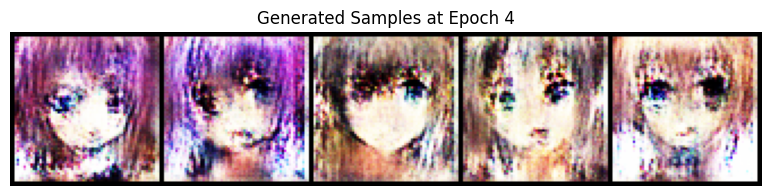

Epoch [5/100] Batch [0/169] Loss D: 0.6094, Loss G: 1.3645
Epoch [5/100] Batch [50/169] Loss D: 0.8546, Loss G: 0.8183
Epoch [5/100] Batch [100/169] Loss D: 0.4546, Loss G: 2.7101
Epoch [5/100] Batch [150/169] Loss D: 0.6469, Loss G: 3.8642


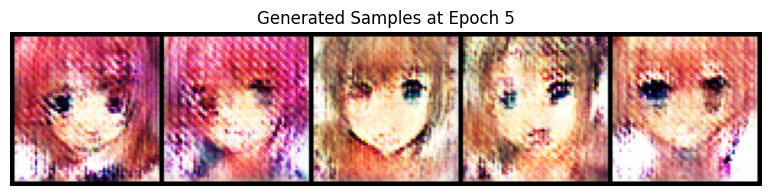

Epoch [6/100] Batch [0/169] Loss D: 0.7951, Loss G: 2.6111
Epoch [6/100] Batch [50/169] Loss D: 1.9889, Loss G: 8.1806
Epoch [6/100] Batch [100/169] Loss D: 0.4835, Loss G: 3.7062
Epoch [6/100] Batch [150/169] Loss D: 0.4530, Loss G: 4.1609


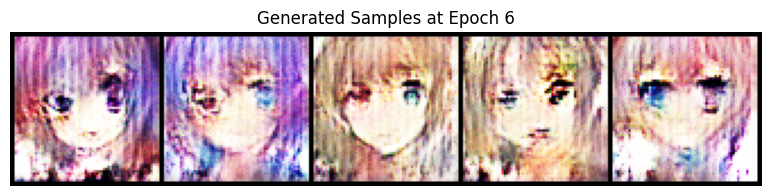

Epoch [7/100] Batch [0/169] Loss D: 1.0588, Loss G: 5.6905
Epoch [7/100] Batch [50/169] Loss D: 0.3967, Loss G: 3.5942
Epoch [7/100] Batch [100/169] Loss D: 0.4798, Loss G: 2.5930
Epoch [7/100] Batch [150/169] Loss D: 1.7403, Loss G: 0.9688


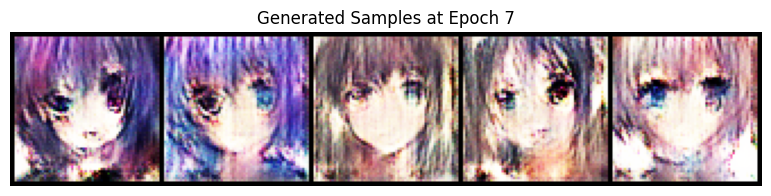

Epoch [8/100] Batch [0/169] Loss D: 0.3509, Loss G: 2.2117
Epoch [8/100] Batch [50/169] Loss D: 0.4452, Loss G: 3.0274
Epoch [8/100] Batch [100/169] Loss D: 0.3957, Loss G: 3.4228
Epoch [8/100] Batch [150/169] Loss D: 0.5907, Loss G: 1.7691


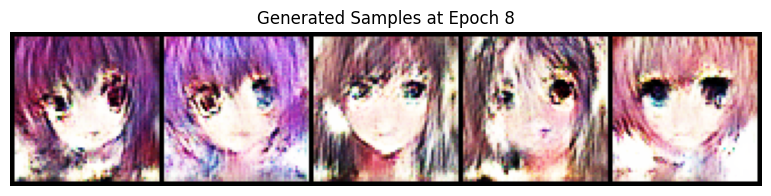

Epoch [9/100] Batch [0/169] Loss D: 0.8660, Loss G: 5.3256
Epoch [9/100] Batch [50/169] Loss D: 0.6587, Loss G: 2.8747
Epoch [9/100] Batch [100/169] Loss D: 0.4723, Loss G: 2.2053
Epoch [9/100] Batch [150/169] Loss D: 0.9080, Loss G: 0.8980


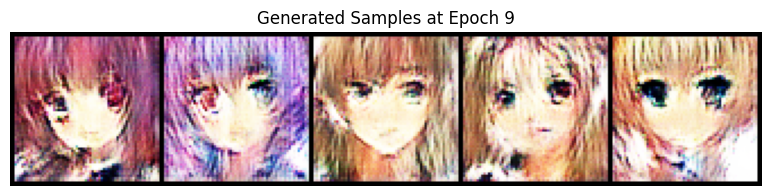

Epoch [10/100] Batch [0/169] Loss D: 0.9582, Loss G: 1.0985
Epoch [10/100] Batch [50/169] Loss D: 0.9519, Loss G: 1.5812
Epoch [10/100] Batch [100/169] Loss D: 0.4724, Loss G: 2.8188
Epoch [10/100] Batch [150/169] Loss D: 0.6727, Loss G: 0.8973


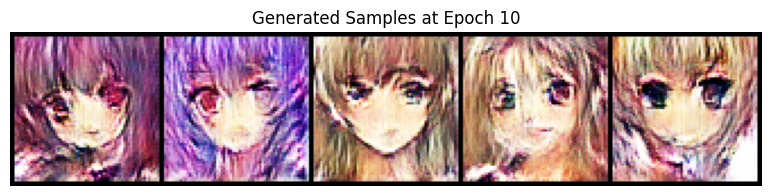

Epoch [11/100] Batch [0/169] Loss D: 0.5676, Loss G: 1.6016
Epoch [11/100] Batch [50/169] Loss D: 0.4853, Loss G: 2.8433
Epoch [11/100] Batch [100/169] Loss D: 0.6818, Loss G: 4.0442
Epoch [11/100] Batch [150/169] Loss D: 0.6441, Loss G: 1.4525


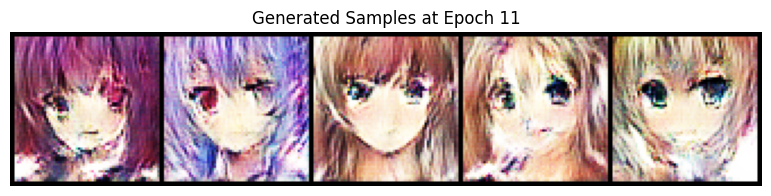

Epoch [12/100] Batch [0/169] Loss D: 0.3756, Loss G: 2.1032
Epoch [12/100] Batch [50/169] Loss D: 0.4507, Loss G: 2.2939
Epoch [12/100] Batch [100/169] Loss D: 0.9527, Loss G: 1.8960
Epoch [12/100] Batch [150/169] Loss D: 0.4627, Loss G: 2.2929


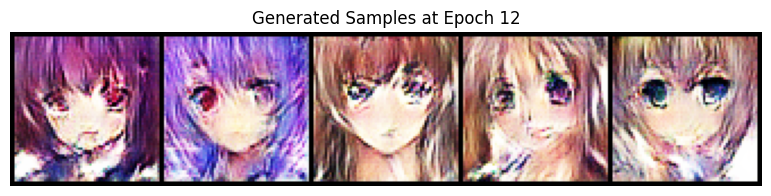

Epoch [13/100] Batch [0/169] Loss D: 0.4716, Loss G: 1.6744
Epoch [13/100] Batch [50/169] Loss D: 0.5196, Loss G: 1.4796
Epoch [13/100] Batch [100/169] Loss D: 0.4242, Loss G: 2.6139
Epoch [13/100] Batch [150/169] Loss D: 0.4392, Loss G: 2.5299


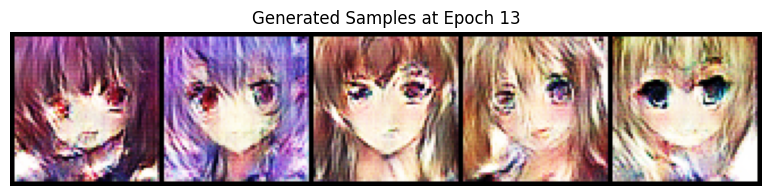

Epoch [14/100] Batch [0/169] Loss D: 0.3618, Loss G: 2.3393
Epoch [14/100] Batch [50/169] Loss D: 1.4569, Loss G: 1.1538
Epoch [14/100] Batch [100/169] Loss D: 0.3628, Loss G: 2.2911
Epoch [14/100] Batch [150/169] Loss D: 0.7025, Loss G: 1.3346


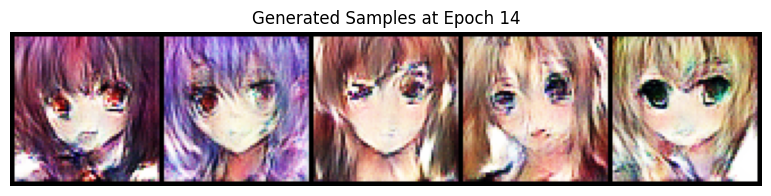

Epoch [15/100] Batch [0/169] Loss D: 0.5382, Loss G: 3.5934
Epoch [15/100] Batch [50/169] Loss D: 0.4335, Loss G: 3.2496
Epoch [15/100] Batch [100/169] Loss D: 0.3067, Loss G: 2.3891
Epoch [15/100] Batch [150/169] Loss D: 0.3671, Loss G: 2.1430


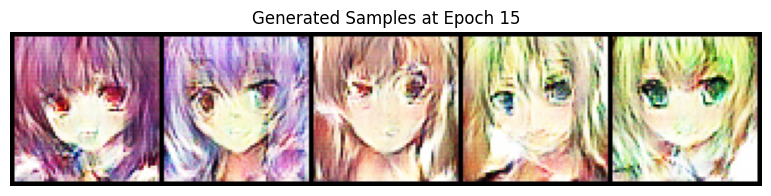

Epoch [16/100] Batch [0/169] Loss D: 1.3670, Loss G: 3.8851
Epoch [16/100] Batch [50/169] Loss D: 1.3598, Loss G: 1.9960
Epoch [16/100] Batch [100/169] Loss D: 0.3394, Loss G: 3.0259
Epoch [16/100] Batch [150/169] Loss D: 0.7427, Loss G: 1.0192


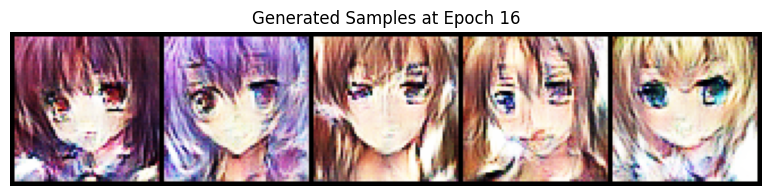

Epoch [17/100] Batch [0/169] Loss D: 0.4447, Loss G: 1.7454
Epoch [17/100] Batch [50/169] Loss D: 0.8839, Loss G: 3.3648
Epoch [17/100] Batch [100/169] Loss D: 0.5437, Loss G: 1.6982
Epoch [17/100] Batch [150/169] Loss D: 0.8629, Loss G: 4.0680


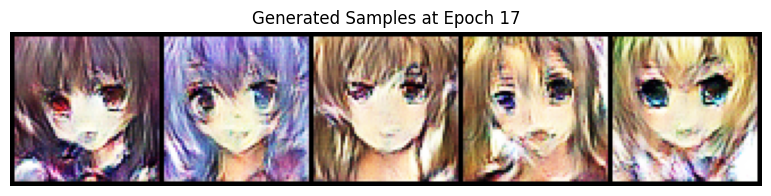

Epoch [18/100] Batch [0/169] Loss D: 0.5377, Loss G: 2.7047
Epoch [18/100] Batch [50/169] Loss D: 0.3455, Loss G: 2.5832
Epoch [18/100] Batch [100/169] Loss D: 1.9109, Loss G: 0.0045
Epoch [18/100] Batch [150/169] Loss D: 0.4117, Loss G: 2.3276


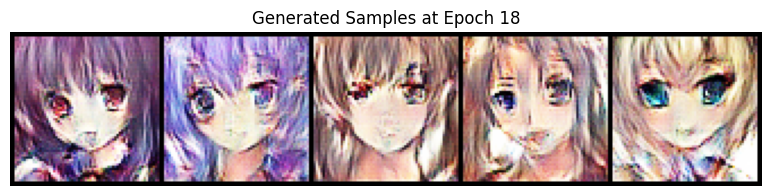

Epoch [19/100] Batch [0/169] Loss D: 2.3766, Loss G: 4.9963
Epoch [19/100] Batch [50/169] Loss D: 0.4996, Loss G: 1.5964
Epoch [19/100] Batch [100/169] Loss D: 0.3828, Loss G: 2.3641
Epoch [19/100] Batch [150/169] Loss D: 0.7805, Loss G: 1.8281


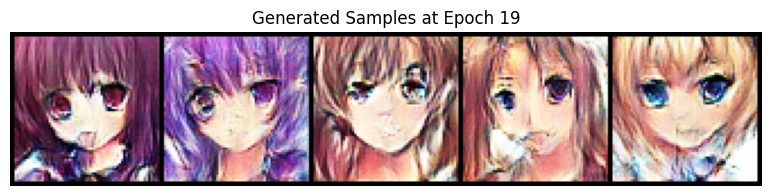

Epoch [20/100] Batch [0/169] Loss D: 1.3989, Loss G: 5.9821
Epoch [20/100] Batch [50/169] Loss D: 0.4048, Loss G: 2.8436
Epoch [20/100] Batch [100/169] Loss D: 0.4234, Loss G: 2.4042
Epoch [20/100] Batch [150/169] Loss D: 0.2274, Loss G: 2.9571


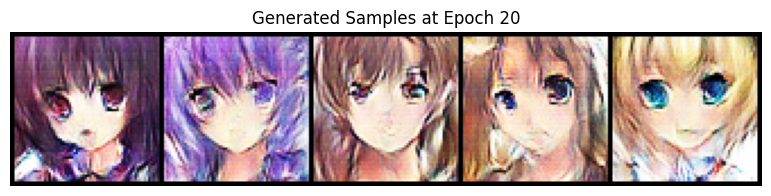

Epoch [21/100] Batch [0/169] Loss D: 0.2089, Loss G: 2.5584
Epoch [21/100] Batch [50/169] Loss D: 0.3166, Loss G: 3.0003
Epoch [21/100] Batch [100/169] Loss D: 0.4665, Loss G: 1.6323
Epoch [21/100] Batch [150/169] Loss D: 1.1354, Loss G: 3.2084


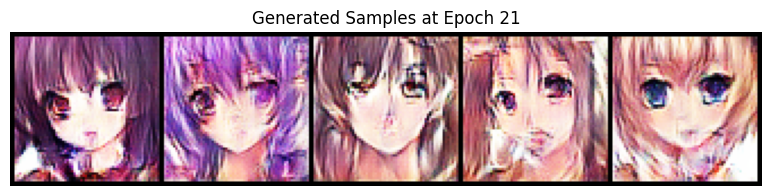

Epoch [22/100] Batch [0/169] Loss D: 0.3965, Loss G: 2.4429
Epoch [22/100] Batch [50/169] Loss D: 0.3337, Loss G: 2.5631
Epoch [22/100] Batch [100/169] Loss D: 1.0249, Loss G: 0.0865
Epoch [22/100] Batch [150/169] Loss D: 0.6038, Loss G: 4.1336


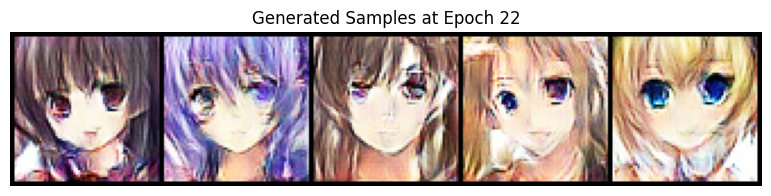

Epoch [23/100] Batch [0/169] Loss D: 0.4283, Loss G: 2.1349
Epoch [23/100] Batch [50/169] Loss D: 0.1985, Loss G: 3.2718
Epoch [23/100] Batch [100/169] Loss D: 0.5367, Loss G: 4.1781
Epoch [23/100] Batch [150/169] Loss D: 0.3405, Loss G: 4.5487


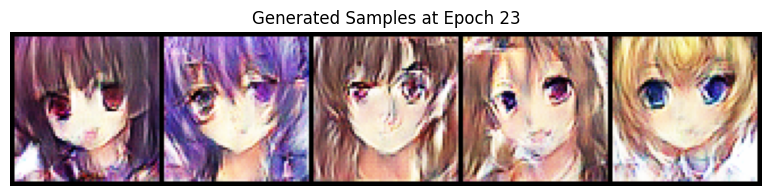

Epoch [24/100] Batch [0/169] Loss D: 0.4321, Loss G: 3.7376
Epoch [24/100] Batch [50/169] Loss D: 0.5282, Loss G: 2.9469
Epoch [24/100] Batch [100/169] Loss D: 0.5690, Loss G: 2.4607
Epoch [24/100] Batch [150/169] Loss D: 0.2829, Loss G: 3.9403


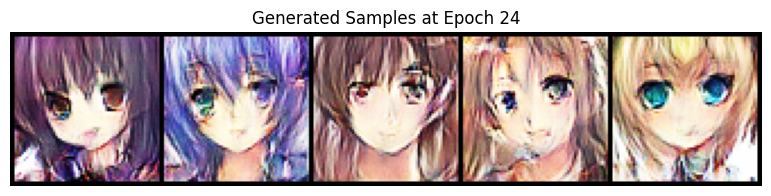

Epoch [25/100] Batch [0/169] Loss D: 0.6718, Loss G: 2.8201
Epoch [25/100] Batch [50/169] Loss D: 0.2171, Loss G: 3.3872
Epoch [25/100] Batch [100/169] Loss D: 0.2766, Loss G: 2.7400
Epoch [25/100] Batch [150/169] Loss D: 0.3724, Loss G: 3.5237


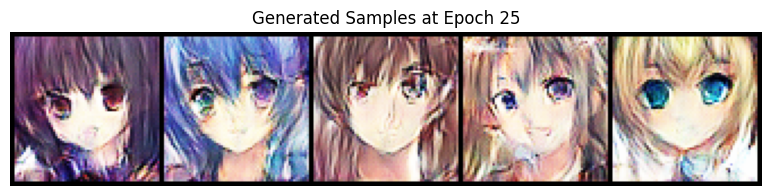

Epoch [26/100] Batch [0/169] Loss D: 0.4789, Loss G: 2.0552
Epoch [26/100] Batch [50/169] Loss D: 0.1925, Loss G: 3.1369
Epoch [26/100] Batch [100/169] Loss D: 0.3088, Loss G: 4.0052
Epoch [26/100] Batch [150/169] Loss D: 0.9083, Loss G: 5.3787


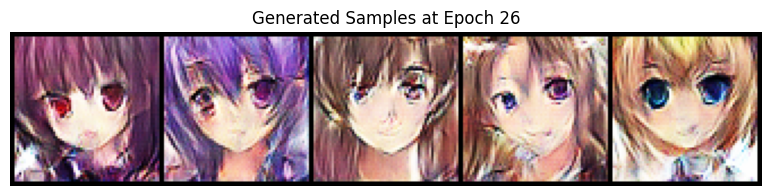

Epoch [27/100] Batch [0/169] Loss D: 0.1865, Loss G: 3.5182
Epoch [27/100] Batch [50/169] Loss D: 1.2042, Loss G: 6.0766
Epoch [27/100] Batch [100/169] Loss D: 0.3886, Loss G: 2.6281
Epoch [27/100] Batch [150/169] Loss D: 0.1603, Loss G: 3.5425


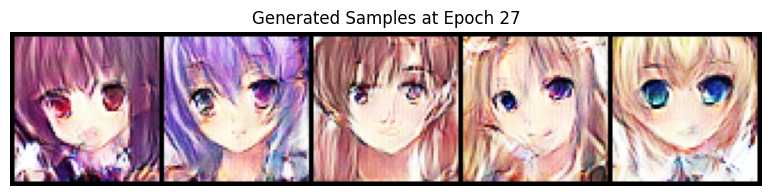

Epoch [28/100] Batch [0/169] Loss D: 0.8981, Loss G: 1.7145
Epoch [28/100] Batch [50/169] Loss D: 0.3805, Loss G: 2.9416
Epoch [28/100] Batch [100/169] Loss D: 0.2555, Loss G: 3.5767
Epoch [28/100] Batch [150/169] Loss D: 0.3134, Loss G: 3.1427


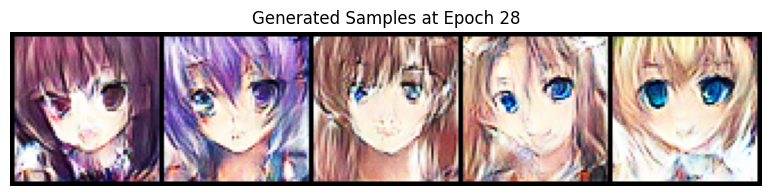

Epoch [29/100] Batch [0/169] Loss D: 0.2663, Loss G: 2.7935
Epoch [29/100] Batch [50/169] Loss D: 0.1767, Loss G: 3.3355
Epoch [29/100] Batch [100/169] Loss D: 0.2461, Loss G: 2.6167
Epoch [29/100] Batch [150/169] Loss D: 0.2153, Loss G: 2.9309


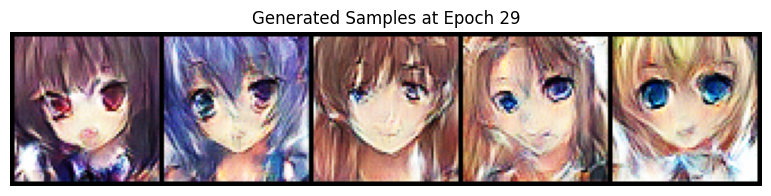

Epoch [30/100] Batch [0/169] Loss D: 0.4600, Loss G: 2.6097
Epoch [30/100] Batch [50/169] Loss D: 0.5281, Loss G: 1.8966
Epoch [30/100] Batch [100/169] Loss D: 0.2116, Loss G: 3.2643
Epoch [30/100] Batch [150/169] Loss D: 0.2351, Loss G: 3.1876


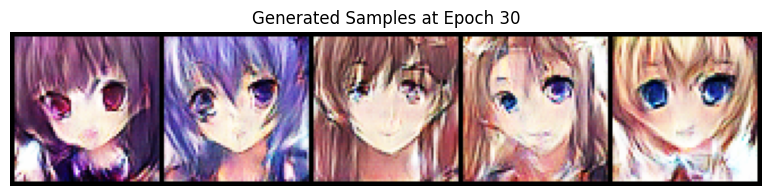

Epoch [31/100] Batch [0/169] Loss D: 0.2444, Loss G: 3.2341
Epoch [31/100] Batch [50/169] Loss D: 0.7139, Loss G: 4.7935
Epoch [31/100] Batch [100/169] Loss D: 0.7759, Loss G: 1.9842
Epoch [31/100] Batch [150/169] Loss D: 0.2342, Loss G: 4.0558


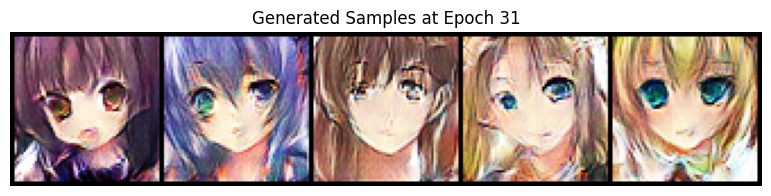

Epoch [32/100] Batch [0/169] Loss D: 0.1277, Loss G: 3.0650
Epoch [32/100] Batch [50/169] Loss D: 0.1278, Loss G: 3.9828
Epoch [32/100] Batch [100/169] Loss D: 0.2083, Loss G: 3.3268
Epoch [32/100] Batch [150/169] Loss D: 0.1702, Loss G: 3.5614


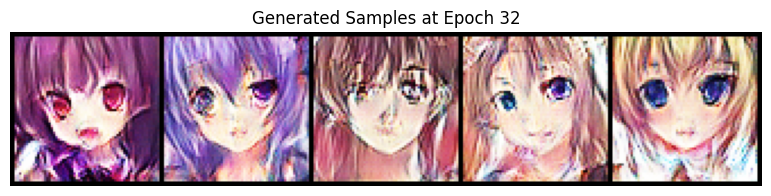

Epoch [33/100] Batch [0/169] Loss D: 0.2074, Loss G: 3.7147
Epoch [33/100] Batch [50/169] Loss D: 0.1656, Loss G: 3.6074
Epoch [33/100] Batch [100/169] Loss D: 0.0366, Loss G: 4.7913
Epoch [33/100] Batch [150/169] Loss D: 0.3647, Loss G: 2.0893


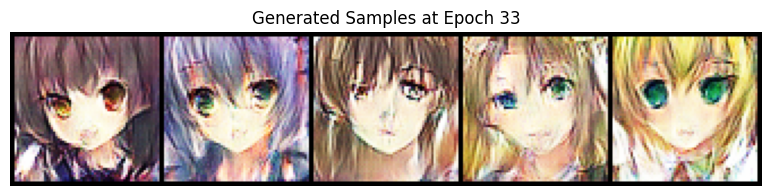

Epoch [34/100] Batch [0/169] Loss D: 0.3441, Loss G: 2.1056
Epoch [34/100] Batch [50/169] Loss D: 0.2077, Loss G: 3.3035
Epoch [34/100] Batch [100/169] Loss D: 0.3032, Loss G: 2.8485
Epoch [34/100] Batch [150/169] Loss D: 0.6439, Loss G: 6.5357


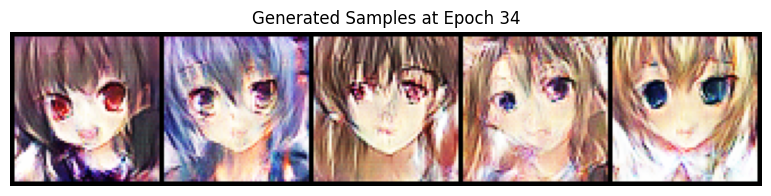

Epoch [35/100] Batch [0/169] Loss D: 0.1393, Loss G: 3.8481
Epoch [35/100] Batch [50/169] Loss D: 0.2846, Loss G: 3.0596
Epoch [35/100] Batch [100/169] Loss D: 0.2489, Loss G: 4.8960
Epoch [35/100] Batch [150/169] Loss D: 0.2381, Loss G: 2.5816


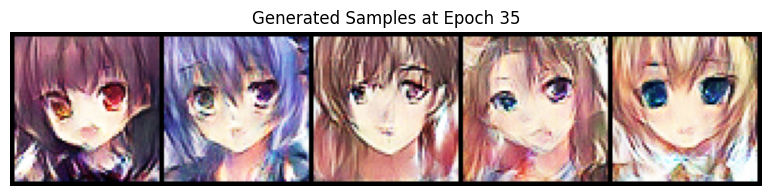

Epoch [36/100] Batch [0/169] Loss D: 1.3874, Loss G: 0.3112
Epoch [36/100] Batch [50/169] Loss D: 1.5981, Loss G: 0.1438
Epoch [36/100] Batch [100/169] Loss D: 0.1686, Loss G: 6.3164
Epoch [36/100] Batch [150/169] Loss D: 2.7558, Loss G: 5.6043


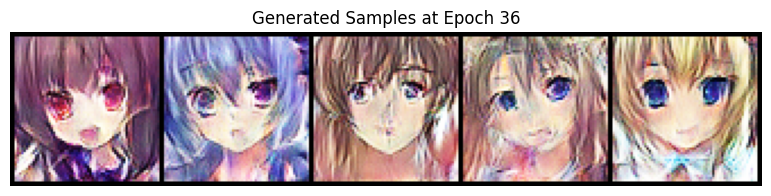

Epoch [37/100] Batch [0/169] Loss D: 0.8822, Loss G: 1.7001
Epoch [37/100] Batch [50/169] Loss D: 0.1440, Loss G: 3.3154
Epoch [37/100] Batch [100/169] Loss D: 0.2033, Loss G: 3.9622
Epoch [37/100] Batch [150/169] Loss D: 0.1805, Loss G: 3.4247


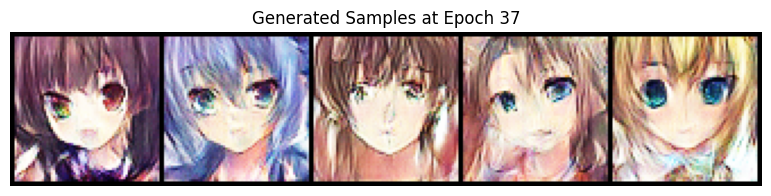

Epoch [38/100] Batch [0/169] Loss D: 0.1706, Loss G: 4.4401
Epoch [38/100] Batch [50/169] Loss D: 1.4491, Loss G: 0.8335
Epoch [38/100] Batch [100/169] Loss D: 0.1269, Loss G: 3.8845
Epoch [38/100] Batch [150/169] Loss D: 0.2035, Loss G: 4.8082


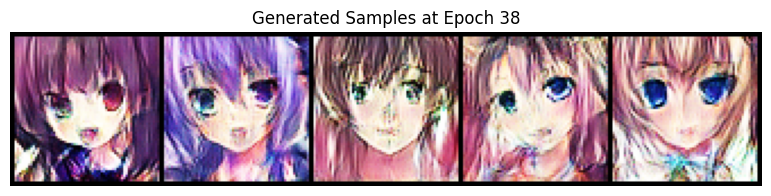

Epoch [39/100] Batch [0/169] Loss D: 0.4208, Loss G: 5.0700
Epoch [39/100] Batch [50/169] Loss D: 0.0909, Loss G: 3.8253
Epoch [39/100] Batch [100/169] Loss D: 0.3568, Loss G: 2.3589
Epoch [39/100] Batch [150/169] Loss D: 0.2965, Loss G: 2.7841


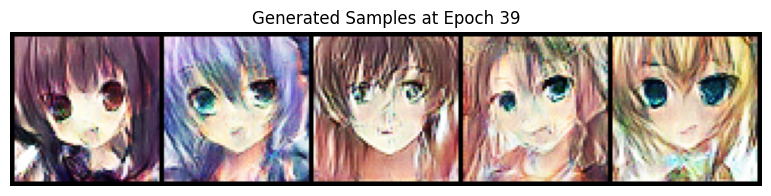

Epoch [40/100] Batch [0/169] Loss D: 0.2629, Loss G: 5.3685
Epoch [40/100] Batch [50/169] Loss D: 0.2049, Loss G: 3.9451
Epoch [40/100] Batch [100/169] Loss D: 0.0506, Loss G: 5.2877
Epoch [40/100] Batch [150/169] Loss D: 0.4880, Loss G: 1.6878


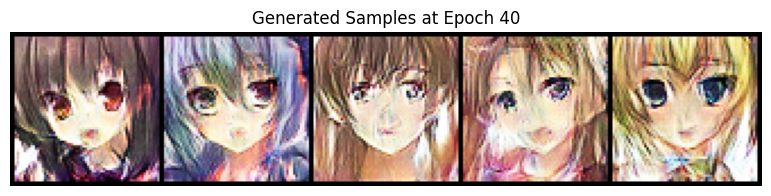

Epoch [41/100] Batch [0/169] Loss D: 0.1351, Loss G: 4.6549
Epoch [41/100] Batch [50/169] Loss D: 0.5447, Loss G: 2.4918
Epoch [41/100] Batch [100/169] Loss D: 0.0765, Loss G: 4.6559
Epoch [41/100] Batch [150/169] Loss D: 0.4034, Loss G: 4.4737


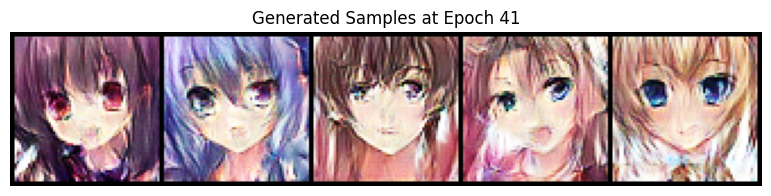

Epoch [42/100] Batch [0/169] Loss D: 0.1043, Loss G: 3.6887
Epoch [42/100] Batch [50/169] Loss D: 0.0923, Loss G: 5.0078
Epoch [42/100] Batch [100/169] Loss D: 0.2020, Loss G: 3.9723
Epoch [42/100] Batch [150/169] Loss D: 0.1662, Loss G: 5.6770


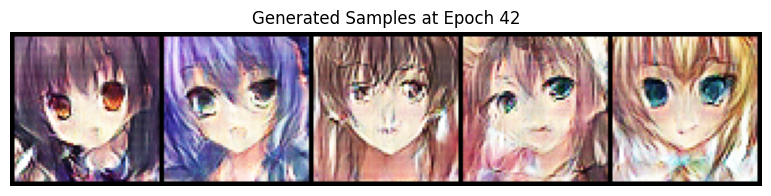

Epoch [43/100] Batch [0/169] Loss D: 0.0752, Loss G: 3.9582
Epoch [43/100] Batch [50/169] Loss D: 0.1530, Loss G: 4.3080
Epoch [43/100] Batch [100/169] Loss D: 0.1303, Loss G: 4.6943
Epoch [43/100] Batch [150/169] Loss D: 0.1686, Loss G: 3.5613


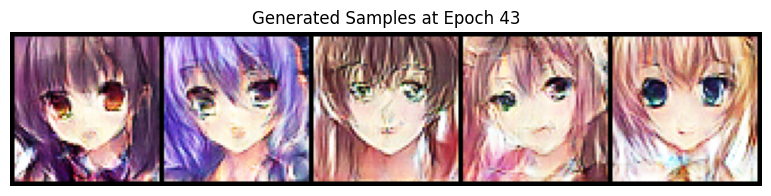

Epoch [44/100] Batch [0/169] Loss D: 0.1739, Loss G: 3.9084
Epoch [44/100] Batch [50/169] Loss D: 0.1676, Loss G: 3.8158
Epoch [44/100] Batch [100/169] Loss D: 0.2676, Loss G: 2.6720
Epoch [44/100] Batch [150/169] Loss D: 0.1370, Loss G: 3.9712


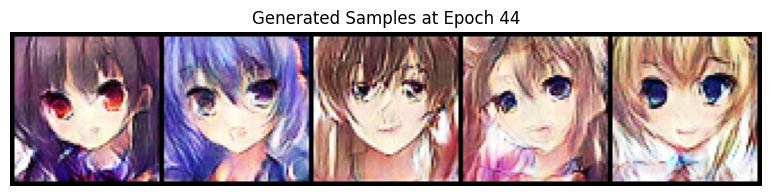

Epoch [45/100] Batch [0/169] Loss D: 0.0442, Loss G: 4.4328
Epoch [45/100] Batch [50/169] Loss D: 0.1293, Loss G: 3.6543
Epoch [45/100] Batch [100/169] Loss D: 0.1022, Loss G: 4.3711
Epoch [45/100] Batch [150/169] Loss D: 0.2265, Loss G: 3.2150


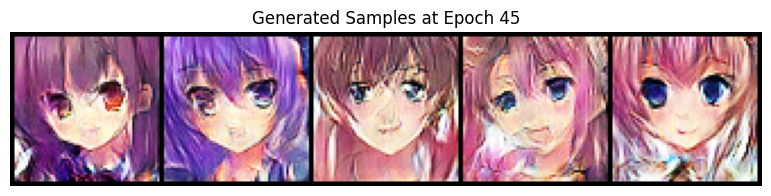

Epoch [46/100] Batch [0/169] Loss D: 0.7539, Loss G: 6.2700
Epoch [46/100] Batch [50/169] Loss D: 0.2885, Loss G: 3.2889
Epoch [46/100] Batch [100/169] Loss D: 0.0748, Loss G: 4.9956
Epoch [46/100] Batch [150/169] Loss D: 0.2338, Loss G: 2.7251


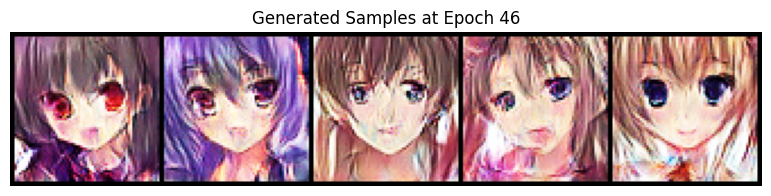

Epoch [47/100] Batch [0/169] Loss D: 0.1547, Loss G: 3.7118
Epoch [47/100] Batch [50/169] Loss D: 1.3045, Loss G: 7.7153
Epoch [47/100] Batch [100/169] Loss D: 0.0441, Loss G: 5.2245
Epoch [47/100] Batch [150/169] Loss D: 0.1865, Loss G: 3.8159


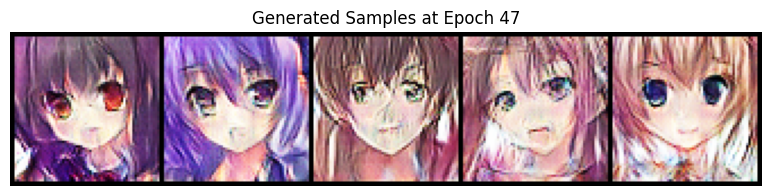

Epoch [48/100] Batch [0/169] Loss D: 0.1268, Loss G: 3.4769
Epoch [48/100] Batch [50/169] Loss D: 0.7016, Loss G: 1.6547
Epoch [48/100] Batch [100/169] Loss D: 0.4051, Loss G: 2.8715
Epoch [48/100] Batch [150/169] Loss D: 0.3276, Loss G: 4.4358


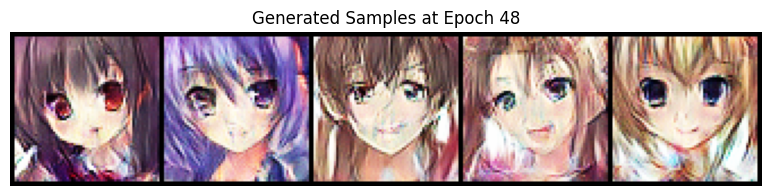

Epoch [49/100] Batch [0/169] Loss D: 0.1104, Loss G: 4.1356
Epoch [49/100] Batch [50/169] Loss D: 0.2716, Loss G: 2.9281
Epoch [49/100] Batch [100/169] Loss D: 0.2325, Loss G: 4.8316
Epoch [49/100] Batch [150/169] Loss D: 0.0961, Loss G: 6.0892


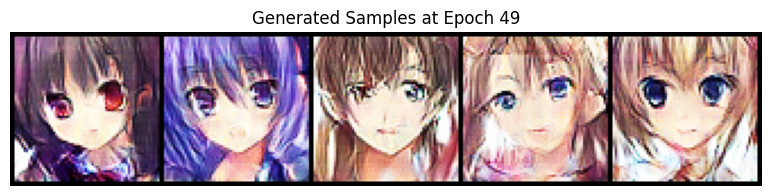

Epoch [50/100] Batch [0/169] Loss D: 0.0359, Loss G: 5.8821
Epoch [50/100] Batch [50/169] Loss D: 0.2368, Loss G: 4.0626
Epoch [50/100] Batch [100/169] Loss D: 0.1712, Loss G: 4.1028
Epoch [50/100] Batch [150/169] Loss D: 0.3601, Loss G: 5.7443


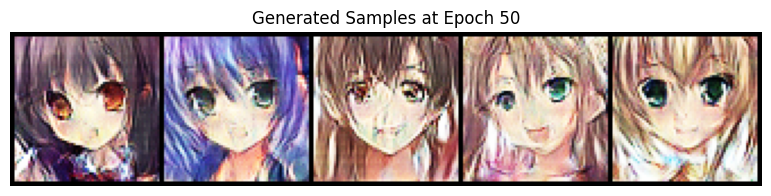

Epoch [51/100] Batch [0/169] Loss D: 0.0584, Loss G: 5.4543
Epoch [51/100] Batch [50/169] Loss D: 0.0605, Loss G: 5.3326
Epoch [51/100] Batch [100/169] Loss D: 0.2187, Loss G: 4.2924
Epoch [51/100] Batch [150/169] Loss D: 1.4935, Loss G: 0.1151


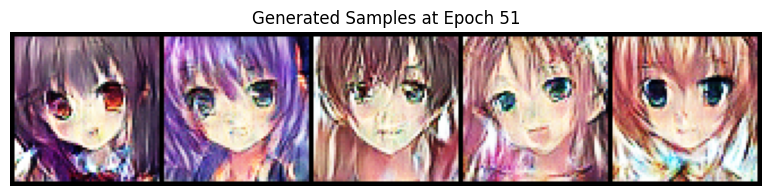

Epoch [52/100] Batch [0/169] Loss D: 0.3372, Loss G: 3.6685
Epoch [52/100] Batch [50/169] Loss D: 0.0459, Loss G: 4.6395
Epoch [52/100] Batch [100/169] Loss D: 0.0697, Loss G: 4.7459
Epoch [52/100] Batch [150/169] Loss D: 0.1678, Loss G: 3.1981


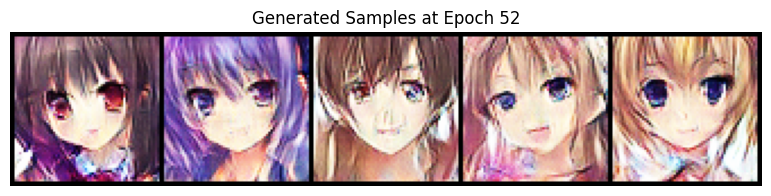

Epoch [53/100] Batch [0/169] Loss D: 0.1789, Loss G: 6.0415
Epoch [53/100] Batch [50/169] Loss D: 0.1426, Loss G: 3.0910
Epoch [53/100] Batch [100/169] Loss D: 0.2369, Loss G: 6.0556
Epoch [53/100] Batch [150/169] Loss D: 0.0238, Loss G: 5.4223


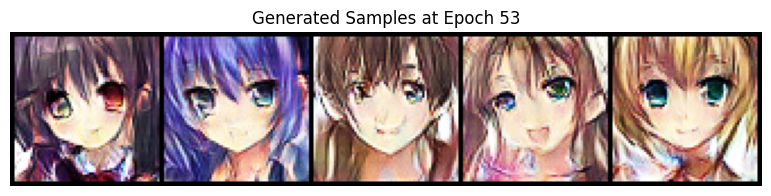

Epoch [54/100] Batch [0/169] Loss D: 0.0910, Loss G: 3.9319
Epoch [54/100] Batch [50/169] Loss D: 0.0782, Loss G: 5.3340
Epoch [54/100] Batch [100/169] Loss D: 0.0773, Loss G: 6.1339
Epoch [54/100] Batch [150/169] Loss D: 0.1372, Loss G: 2.7149


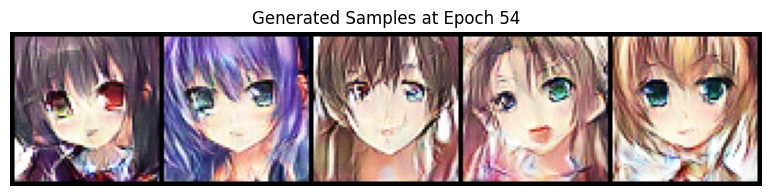

Epoch [55/100] Batch [0/169] Loss D: 0.0807, Loss G: 4.7626
Epoch [55/100] Batch [50/169] Loss D: 0.1881, Loss G: 4.3047
Epoch [55/100] Batch [100/169] Loss D: 0.0278, Loss G: 5.5859
Epoch [55/100] Batch [150/169] Loss D: 0.4922, Loss G: 4.0046


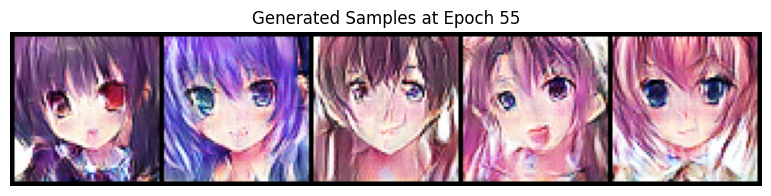

Epoch [56/100] Batch [0/169] Loss D: 0.0662, Loss G: 4.4498
Epoch [56/100] Batch [50/169] Loss D: 0.0692, Loss G: 5.7261
Epoch [56/100] Batch [100/169] Loss D: 0.0578, Loss G: 4.6910
Epoch [56/100] Batch [150/169] Loss D: 0.1497, Loss G: 5.7223


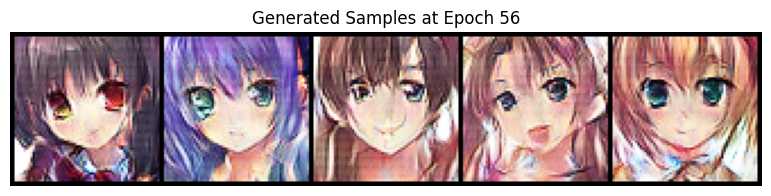

Epoch [57/100] Batch [0/169] Loss D: 0.0622, Loss G: 5.0547
Epoch [57/100] Batch [50/169] Loss D: 0.4004, Loss G: 2.7951
Epoch [57/100] Batch [100/169] Loss D: 0.0728, Loss G: 5.2708
Epoch [57/100] Batch [150/169] Loss D: 0.0699, Loss G: 4.7493


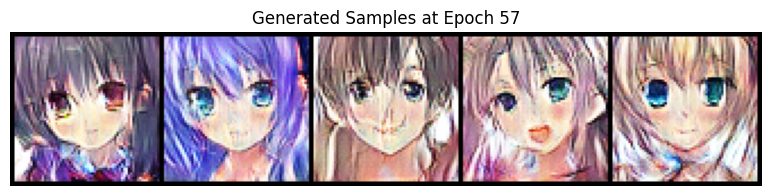

Epoch [58/100] Batch [0/169] Loss D: 0.6533, Loss G: 4.6684
Epoch [58/100] Batch [50/169] Loss D: 0.2149, Loss G: 4.7045
Epoch [58/100] Batch [100/169] Loss D: 0.1819, Loss G: 3.1059
Epoch [58/100] Batch [150/169] Loss D: 0.1869, Loss G: 2.9024


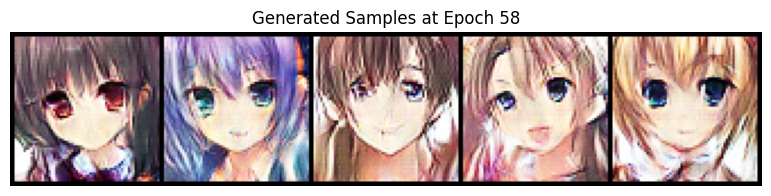

Epoch [59/100] Batch [0/169] Loss D: 0.0305, Loss G: 5.3201
Epoch [59/100] Batch [50/169] Loss D: 0.1135, Loss G: 5.9967
Epoch [59/100] Batch [100/169] Loss D: 0.0599, Loss G: 6.0805
Epoch [59/100] Batch [150/169] Loss D: 0.0236, Loss G: 5.9468


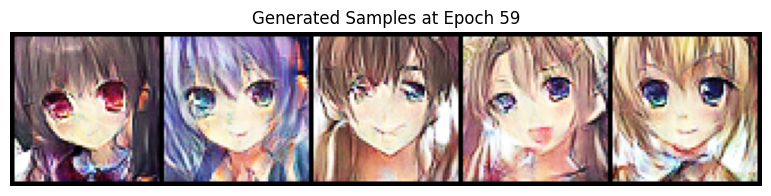

Epoch [60/100] Batch [0/169] Loss D: 0.1030, Loss G: 5.2351
Epoch [60/100] Batch [50/169] Loss D: 3.6373, Loss G: 7.0760
Epoch [60/100] Batch [100/169] Loss D: 0.9998, Loss G: 1.8399
Epoch [60/100] Batch [150/169] Loss D: 0.1660, Loss G: 3.7318


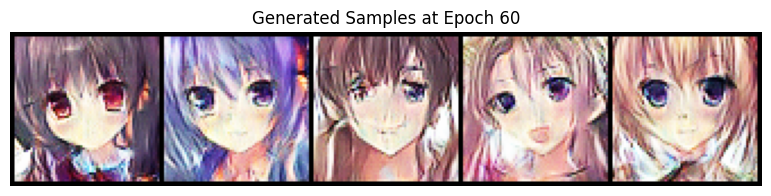

Epoch [61/100] Batch [0/169] Loss D: 0.1207, Loss G: 4.7713
Epoch [61/100] Batch [50/169] Loss D: 0.0711, Loss G: 5.4198
Epoch [61/100] Batch [100/169] Loss D: 0.0365, Loss G: 5.5495
Epoch [61/100] Batch [150/169] Loss D: 0.0466, Loss G: 5.7865


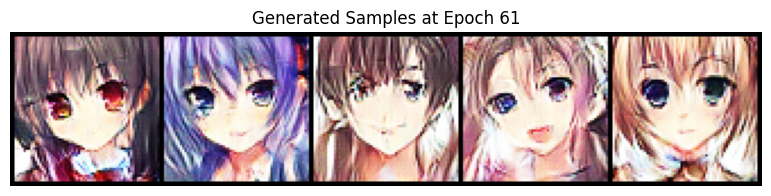

Epoch [62/100] Batch [0/169] Loss D: 0.0309, Loss G: 5.4421
Epoch [62/100] Batch [50/169] Loss D: 0.0317, Loss G: 5.6650
Epoch [62/100] Batch [100/169] Loss D: 0.1088, Loss G: 5.4586
Epoch [62/100] Batch [150/169] Loss D: 0.1181, Loss G: 4.6655


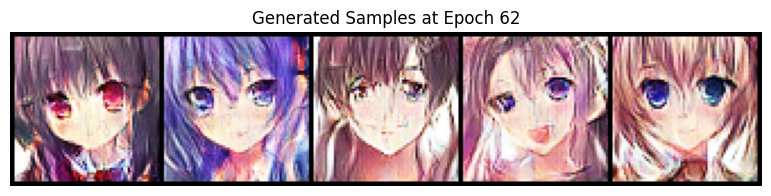

Epoch [63/100] Batch [0/169] Loss D: 0.3107, Loss G: 4.8472
Epoch [63/100] Batch [50/169] Loss D: 0.1037, Loss G: 6.5681
Epoch [63/100] Batch [100/169] Loss D: 0.1103, Loss G: 4.2602
Epoch [63/100] Batch [150/169] Loss D: 0.0870, Loss G: 6.0883


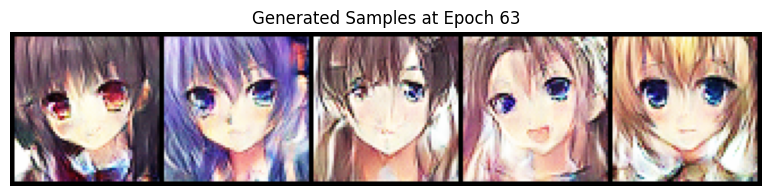

Epoch [64/100] Batch [0/169] Loss D: 0.8321, Loss G: 8.6596
Epoch [64/100] Batch [50/169] Loss D: 0.1811, Loss G: 4.6754
Epoch [64/100] Batch [100/169] Loss D: 0.1346, Loss G: 3.6967
Epoch [64/100] Batch [150/169] Loss D: 0.0815, Loss G: 4.5137


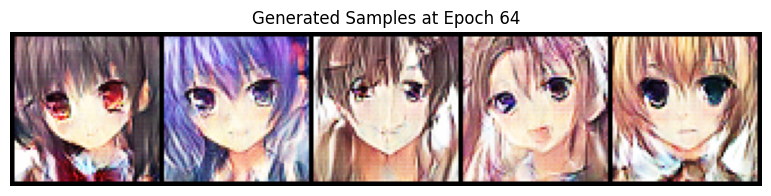

Epoch [65/100] Batch [0/169] Loss D: 0.0161, Loss G: 6.2261
Epoch [65/100] Batch [50/169] Loss D: 0.1187, Loss G: 5.6809
Epoch [65/100] Batch [100/169] Loss D: 0.0197, Loss G: 5.9131
Epoch [65/100] Batch [150/169] Loss D: 0.0915, Loss G: 8.2257


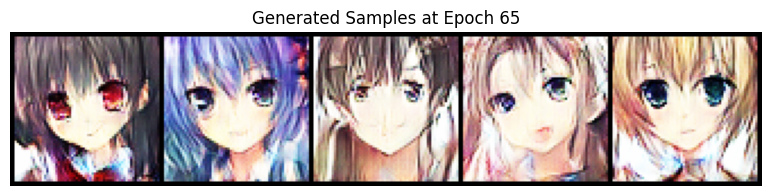

Epoch [66/100] Batch [0/169] Loss D: 1.3991, Loss G: 0.8356
Epoch [66/100] Batch [50/169] Loss D: 0.2552, Loss G: 4.9205
Epoch [66/100] Batch [100/169] Loss D: 0.0964, Loss G: 4.9674
Epoch [66/100] Batch [150/169] Loss D: 0.0686, Loss G: 4.1042


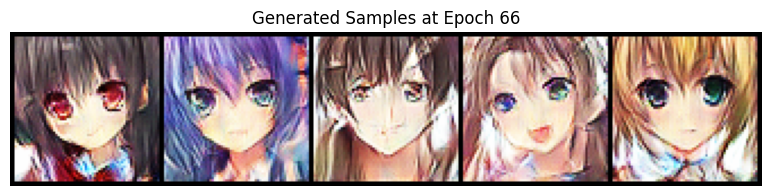

Epoch [67/100] Batch [0/169] Loss D: 0.0559, Loss G: 5.4836
Epoch [67/100] Batch [50/169] Loss D: 0.0698, Loss G: 5.9701
Epoch [67/100] Batch [100/169] Loss D: 0.2394, Loss G: 4.1291
Epoch [67/100] Batch [150/169] Loss D: 0.0495, Loss G: 4.8255


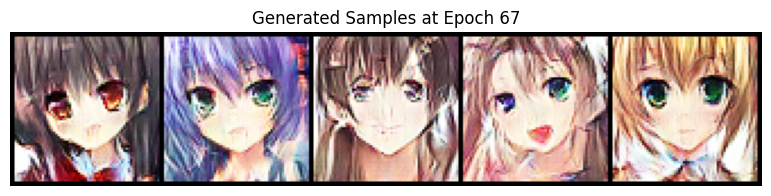

Epoch [68/100] Batch [0/169] Loss D: 0.0990, Loss G: 6.2013
Epoch [68/100] Batch [50/169] Loss D: 0.0648, Loss G: 5.2944
Epoch [68/100] Batch [100/169] Loss D: 0.0410, Loss G: 5.8557
Epoch [68/100] Batch [150/169] Loss D: 0.9477, Loss G: 1.7912


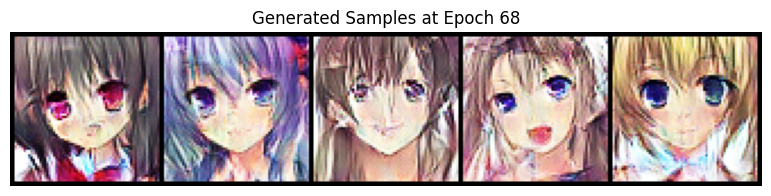

Epoch [69/100] Batch [0/169] Loss D: 0.1154, Loss G: 4.8114
Epoch [69/100] Batch [50/169] Loss D: 0.0402, Loss G: 5.6433
Epoch [69/100] Batch [100/169] Loss D: 0.0546, Loss G: 5.8946
Epoch [69/100] Batch [150/169] Loss D: 0.0255, Loss G: 5.3342


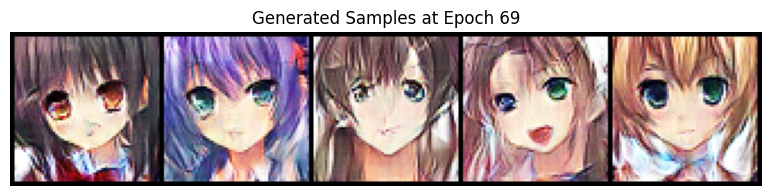

Epoch [70/100] Batch [0/169] Loss D: 0.0244, Loss G: 5.8624
Epoch [70/100] Batch [50/169] Loss D: 0.1138, Loss G: 5.9807
Epoch [70/100] Batch [100/169] Loss D: 0.4273, Loss G: 3.2441
Epoch [70/100] Batch [150/169] Loss D: 0.0879, Loss G: 4.7330


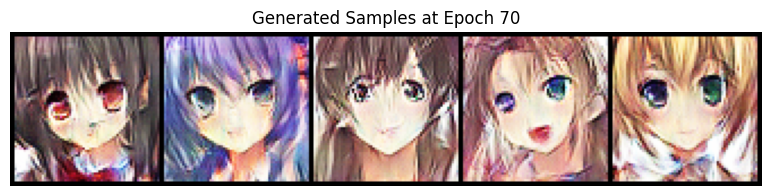

Epoch [71/100] Batch [0/169] Loss D: 0.0513, Loss G: 5.6097
Epoch [71/100] Batch [50/169] Loss D: 1.9932, Loss G: 0.3442
Epoch [71/100] Batch [100/169] Loss D: 0.1418, Loss G: 5.0135
Epoch [71/100] Batch [150/169] Loss D: 0.0658, Loss G: 5.1966


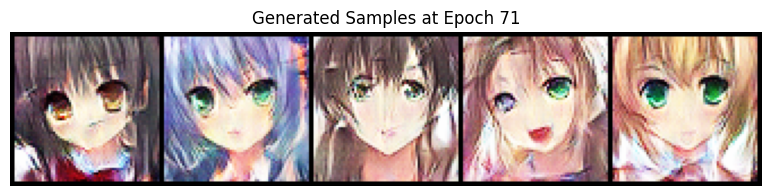

Epoch [72/100] Batch [0/169] Loss D: 0.0347, Loss G: 5.9807
Epoch [72/100] Batch [50/169] Loss D: 0.0314, Loss G: 5.9661
Epoch [72/100] Batch [100/169] Loss D: 0.1030, Loss G: 4.7921
Epoch [72/100] Batch [150/169] Loss D: 0.0494, Loss G: 4.6798


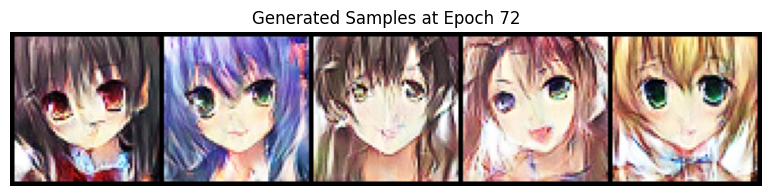

Epoch [73/100] Batch [0/169] Loss D: 0.0315, Loss G: 6.1086
Epoch [73/100] Batch [50/169] Loss D: 0.1425, Loss G: 3.4744
Epoch [73/100] Batch [100/169] Loss D: 0.0348, Loss G: 5.3033
Epoch [73/100] Batch [150/169] Loss D: 0.0175, Loss G: 6.5611


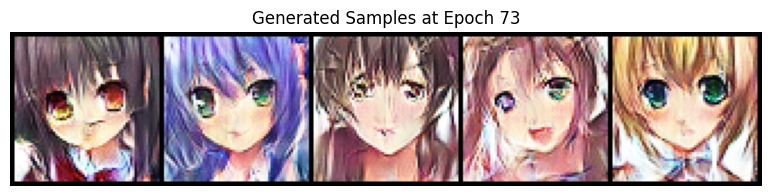

Epoch [74/100] Batch [0/169] Loss D: 0.1863, Loss G: 7.6024
Epoch [74/100] Batch [50/169] Loss D: 0.1238, Loss G: 4.5649
Epoch [74/100] Batch [100/169] Loss D: 0.0358, Loss G: 6.0846
Epoch [74/100] Batch [150/169] Loss D: 1.0910, Loss G: 1.0026


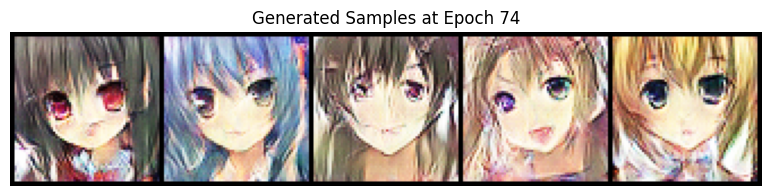

Epoch [75/100] Batch [0/169] Loss D: 0.0616, Loss G: 5.7443
Epoch [75/100] Batch [50/169] Loss D: 0.0098, Loss G: 6.3992
Epoch [75/100] Batch [100/169] Loss D: 0.0459, Loss G: 6.0178
Epoch [75/100] Batch [150/169] Loss D: 0.0638, Loss G: 5.6615


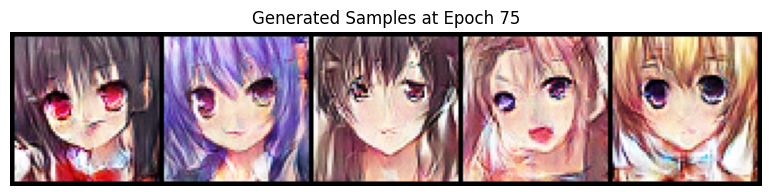

Epoch [76/100] Batch [0/169] Loss D: 1.6469, Loss G: 7.4278
Epoch [76/100] Batch [50/169] Loss D: 0.1260, Loss G: 4.5845
Epoch [76/100] Batch [100/169] Loss D: 0.0386, Loss G: 5.4412
Epoch [76/100] Batch [150/169] Loss D: 0.0271, Loss G: 5.3106


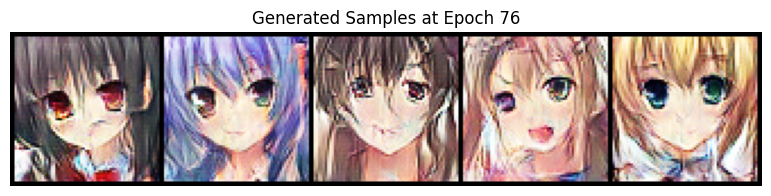

Epoch [77/100] Batch [0/169] Loss D: 0.1307, Loss G: 6.4233
Epoch [77/100] Batch [50/169] Loss D: 0.0685, Loss G: 6.0238
Epoch [77/100] Batch [100/169] Loss D: 0.5155, Loss G: 6.2183
Epoch [77/100] Batch [150/169] Loss D: 1.9962, Loss G: 0.6389


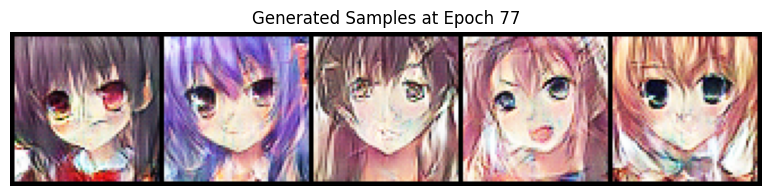

Epoch [78/100] Batch [0/169] Loss D: 0.0426, Loss G: 5.5384
Epoch [78/100] Batch [50/169] Loss D: 0.4840, Loss G: 3.8745
Epoch [78/100] Batch [100/169] Loss D: 0.1079, Loss G: 4.6359
Epoch [78/100] Batch [150/169] Loss D: 0.1058, Loss G: 4.8132


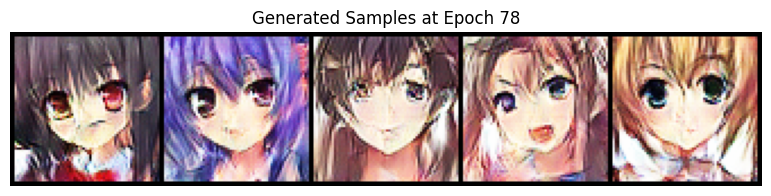

Epoch [79/100] Batch [0/169] Loss D: 0.0468, Loss G: 5.1958
Epoch [79/100] Batch [50/169] Loss D: 0.0766, Loss G: 5.7571
Epoch [79/100] Batch [100/169] Loss D: 0.1958, Loss G: 3.8413
Epoch [79/100] Batch [150/169] Loss D: 0.4713, Loss G: 2.5072


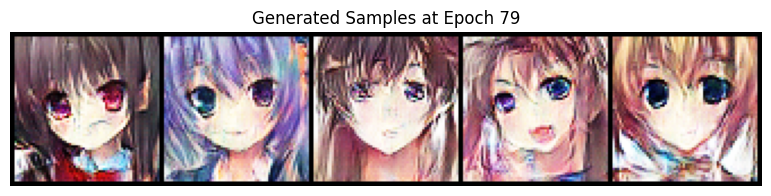

Epoch [80/100] Batch [0/169] Loss D: 0.1871, Loss G: 3.7876
Epoch [80/100] Batch [50/169] Loss D: 0.4255, Loss G: 7.8160
Epoch [80/100] Batch [100/169] Loss D: 0.0563, Loss G: 5.3992
Epoch [80/100] Batch [150/169] Loss D: 0.0482, Loss G: 5.5161


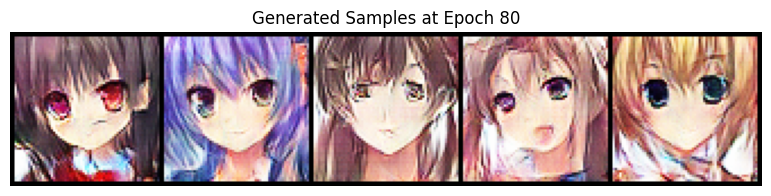

Epoch [81/100] Batch [0/169] Loss D: 0.0283, Loss G: 6.0025
Epoch [81/100] Batch [50/169] Loss D: 0.0545, Loss G: 4.7008
Epoch [81/100] Batch [100/169] Loss D: 0.0323, Loss G: 5.4476
Epoch [81/100] Batch [150/169] Loss D: 0.8209, Loss G: 3.4963


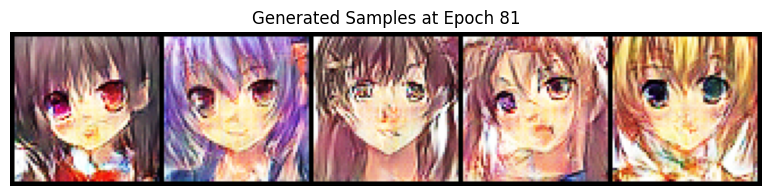

Epoch [82/100] Batch [0/169] Loss D: 0.2430, Loss G: 5.7562
Epoch [82/100] Batch [50/169] Loss D: 0.0684, Loss G: 5.0185
Epoch [82/100] Batch [100/169] Loss D: 0.0288, Loss G: 5.5310
Epoch [82/100] Batch [150/169] Loss D: 0.0190, Loss G: 5.9783


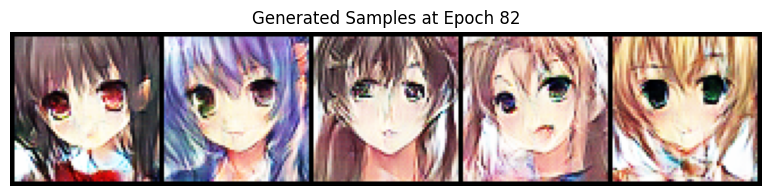

Epoch [83/100] Batch [0/169] Loss D: 0.0212, Loss G: 5.3823
Epoch [83/100] Batch [50/169] Loss D: 0.0273, Loss G: 6.0315
Epoch [83/100] Batch [100/169] Loss D: 0.0697, Loss G: 5.3081
Epoch [83/100] Batch [150/169] Loss D: 0.0372, Loss G: 6.1642


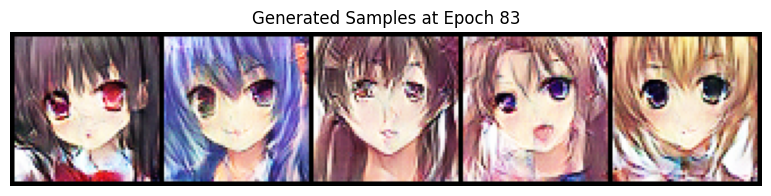

Epoch [84/100] Batch [0/169] Loss D: 0.0345, Loss G: 6.4019
Epoch [84/100] Batch [50/169] Loss D: 0.0228, Loss G: 6.0014
Epoch [84/100] Batch [100/169] Loss D: 0.0499, Loss G: 5.0829
Epoch [84/100] Batch [150/169] Loss D: 0.0177, Loss G: 6.4203


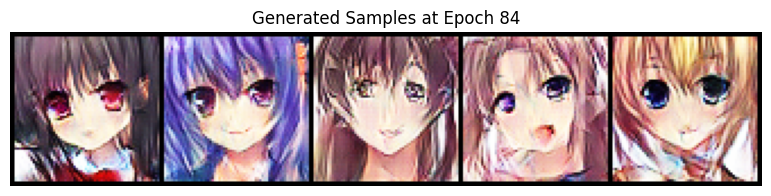

Epoch [85/100] Batch [0/169] Loss D: 0.0655, Loss G: 7.6753
Epoch [85/100] Batch [50/169] Loss D: 1.1455, Loss G: 3.8675
Epoch [85/100] Batch [100/169] Loss D: 0.4125, Loss G: 8.3136
Epoch [85/100] Batch [150/169] Loss D: 0.0363, Loss G: 6.1536


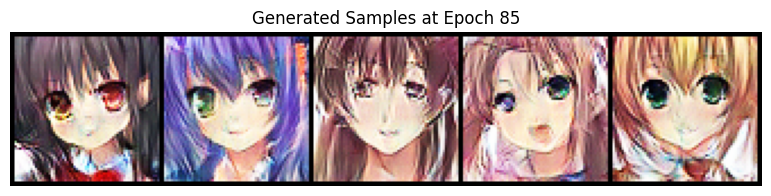

Epoch [86/100] Batch [0/169] Loss D: 0.0329, Loss G: 5.7250
Epoch [86/100] Batch [50/169] Loss D: 0.0092, Loss G: 6.9827
Epoch [86/100] Batch [100/169] Loss D: 1.7154, Loss G: 2.5123
Epoch [86/100] Batch [150/169] Loss D: 0.0874, Loss G: 4.6406


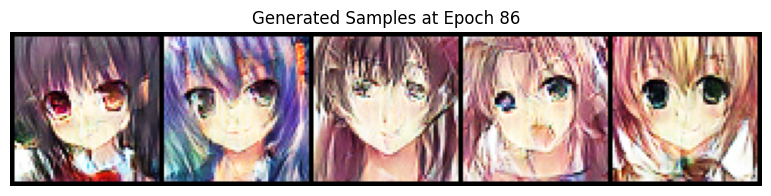

Epoch [87/100] Batch [0/169] Loss D: 0.3269, Loss G: 5.7754
Epoch [87/100] Batch [50/169] Loss D: 1.1741, Loss G: 1.8817
Epoch [87/100] Batch [100/169] Loss D: 0.1609, Loss G: 5.1454
Epoch [87/100] Batch [150/169] Loss D: 0.0529, Loss G: 5.6863


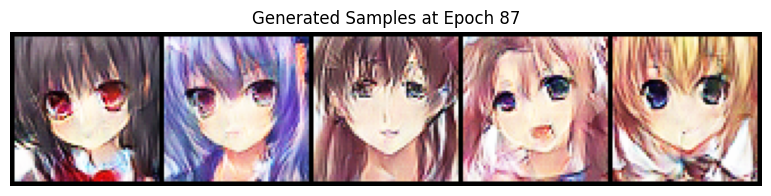

Epoch [88/100] Batch [0/169] Loss D: 0.4423, Loss G: 10.0621
Epoch [88/100] Batch [50/169] Loss D: 0.0464, Loss G: 5.5270
Epoch [88/100] Batch [100/169] Loss D: 0.0586, Loss G: 5.2064
Epoch [88/100] Batch [150/169] Loss D: 0.0132, Loss G: 6.3331


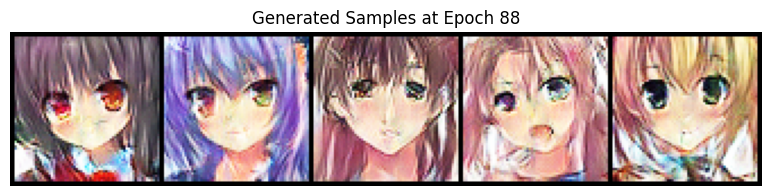

Epoch [89/100] Batch [0/169] Loss D: 0.0936, Loss G: 4.7647
Epoch [89/100] Batch [50/169] Loss D: 0.0512, Loss G: 6.7456
Epoch [89/100] Batch [100/169] Loss D: 0.0506, Loss G: 5.2403
Epoch [89/100] Batch [150/169] Loss D: 0.0144, Loss G: 6.0235


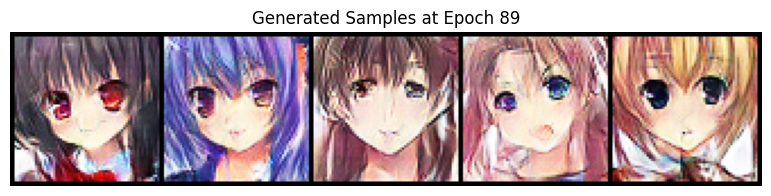

Epoch [90/100] Batch [0/169] Loss D: 0.0159, Loss G: 6.2927
Epoch [90/100] Batch [50/169] Loss D: 0.0191, Loss G: 6.5599
Epoch [90/100] Batch [100/169] Loss D: 0.0190, Loss G: 6.5144
Epoch [90/100] Batch [150/169] Loss D: 0.0531, Loss G: 5.5144


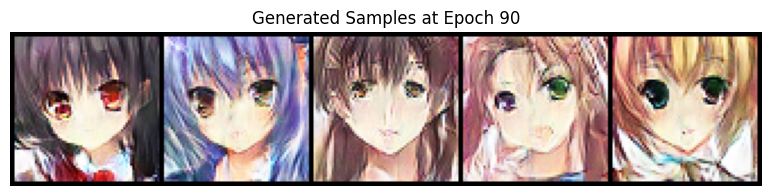

Epoch [91/100] Batch [0/169] Loss D: 0.0439, Loss G: 5.7039
Epoch [91/100] Batch [50/169] Loss D: 0.0776, Loss G: 4.7635
Epoch [91/100] Batch [100/169] Loss D: 0.0506, Loss G: 5.4537
Epoch [91/100] Batch [150/169] Loss D: 0.0265, Loss G: 6.0780


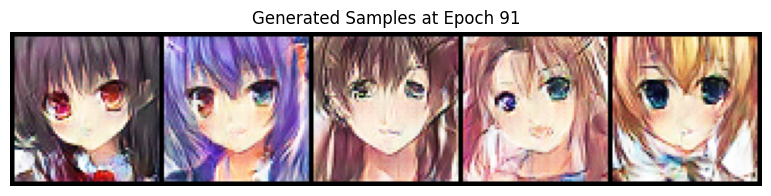

Epoch [92/100] Batch [0/169] Loss D: 0.0440, Loss G: 5.1464
Epoch [92/100] Batch [50/169] Loss D: 0.0271, Loss G: 6.8340
Epoch [92/100] Batch [100/169] Loss D: 0.0103, Loss G: 6.8296
Epoch [92/100] Batch [150/169] Loss D: 0.1680, Loss G: 5.1958


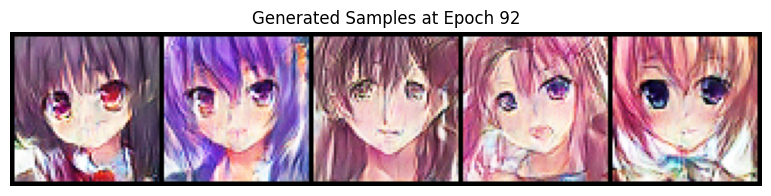

Epoch [93/100] Batch [0/169] Loss D: 0.0547, Loss G: 5.3498
Epoch [93/100] Batch [50/169] Loss D: 0.2251, Loss G: 3.8263
Epoch [93/100] Batch [100/169] Loss D: 0.9623, Loss G: 3.2743
Epoch [93/100] Batch [150/169] Loss D: 0.0527, Loss G: 5.4693


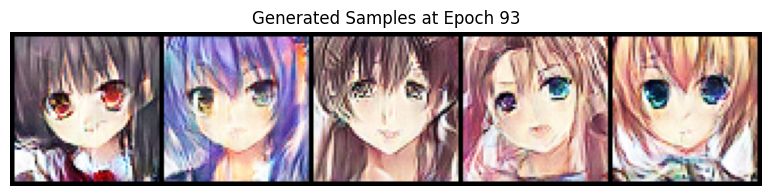

Epoch [94/100] Batch [0/169] Loss D: 0.0967, Loss G: 7.3049
Epoch [94/100] Batch [50/169] Loss D: 0.0207, Loss G: 5.5486
Epoch [94/100] Batch [100/169] Loss D: 0.0857, Loss G: 8.0196
Epoch [94/100] Batch [150/169] Loss D: 0.1182, Loss G: 6.8873


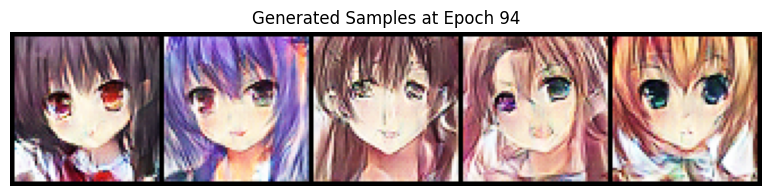

Epoch [95/100] Batch [0/169] Loss D: 0.0193, Loss G: 6.1886
Epoch [95/100] Batch [50/169] Loss D: 0.0090, Loss G: 6.0819
Epoch [95/100] Batch [100/169] Loss D: 0.0668, Loss G: 4.6894
Epoch [95/100] Batch [150/169] Loss D: 0.0320, Loss G: 6.0931


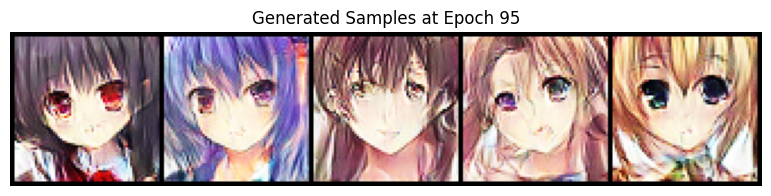

Epoch [96/100] Batch [0/169] Loss D: 1.0429, Loss G: 4.0588
Epoch [96/100] Batch [50/169] Loss D: 4.6453, Loss G: 0.1340
Epoch [96/100] Batch [100/169] Loss D: 0.0686, Loss G: 5.7479
Epoch [96/100] Batch [150/169] Loss D: 0.0609, Loss G: 4.8131


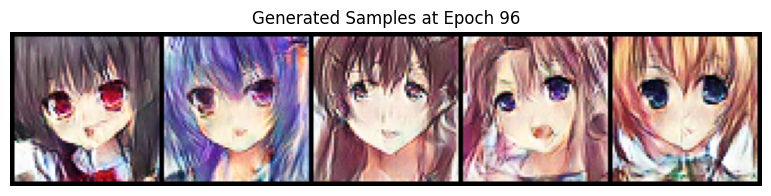

Epoch [97/100] Batch [0/169] Loss D: 0.4738, Loss G: 3.1993
Epoch [97/100] Batch [50/169] Loss D: 0.0518, Loss G: 5.5434
Epoch [97/100] Batch [100/169] Loss D: 0.0554, Loss G: 6.2799
Epoch [97/100] Batch [150/169] Loss D: 0.0316, Loss G: 5.8842


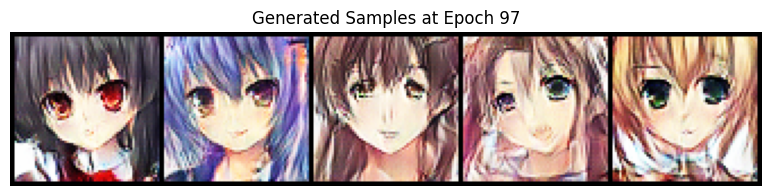

Epoch [98/100] Batch [0/169] Loss D: 0.0241, Loss G: 6.4053
Epoch [98/100] Batch [50/169] Loss D: 0.0375, Loss G: 5.5920
Epoch [98/100] Batch [100/169] Loss D: 0.0245, Loss G: 6.7336
Epoch [98/100] Batch [150/169] Loss D: 0.0281, Loss G: 6.7646


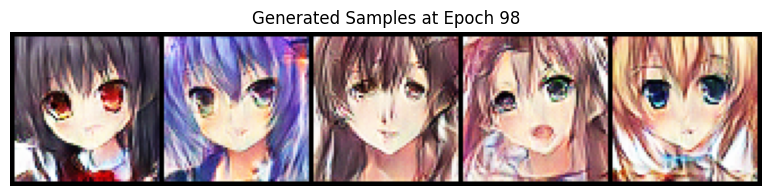

Epoch [99/100] Batch [0/169] Loss D: 0.0532, Loss G: 6.3191
Epoch [99/100] Batch [50/169] Loss D: 0.0169, Loss G: 6.5104
Epoch [99/100] Batch [100/169] Loss D: 0.6394, Loss G: 1.6071
Epoch [99/100] Batch [150/169] Loss D: 0.1088, Loss G: 4.3250


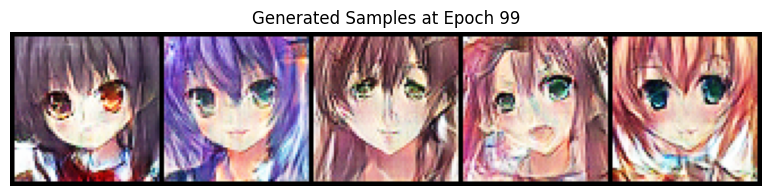

Epoch [100/100] Batch [0/169] Loss D: 0.0399, Loss G: 5.0190
Epoch [100/100] Batch [50/169] Loss D: 0.0260, Loss G: 6.6052
Epoch [100/100] Batch [100/169] Loss D: 0.0442, Loss G: 5.1803
Epoch [100/100] Batch [150/169] Loss D: 0.0396, Loss G: 5.7173


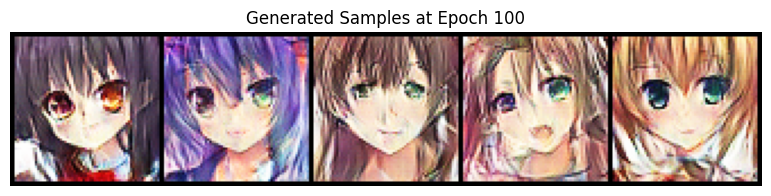

Training complete.


In [ ]:
# Generate fixed noise once to track progress (25 images = 5x5 grid)
fixed_noise = torch.randn(25, latent_dim, device=device)

# Visualization function
def visualize_generated_images(generator, fixed_noise, epoch, num_imgs=5):
    generator.eval()
    with torch.no_grad():
        fake_images = generator(fixed_noise).detach().cpu()
        fake_images = fake_images * 0.5 + 0.5  # Unnormalize from [-1, 1] to [0, 1]

    grid = make_grid(fake_images[:num_imgs], nrow=num_imgs, normalize=False)
    np_grid = grid.permute(1, 2, 0).numpy()  # C x H x W → H x W x C

    plt.figure(figsize=(num_imgs * 2, 2))
    plt.imshow(np_grid)
    plt.axis('off')
    plt.title(f"Generated Samples at Epoch {epoch + 1}")
    plt.show()


# ========== Training Loop ==========
for epoch in range(epochs):
    for i, (real_images, _) in enumerate(dataloader):
        batch_size_curr = real_images.size(0)
        real_images = real_images.to(device)

        # Ground truths
        real_labels = torch.ones(batch_size_curr, device=device)
        fake_labels = torch.zeros(batch_size_curr, device=device)

        ####### Train Discriminator ########
        optimizer_D.zero_grad()

        # Real images
        outputs_real = discriminator(real_images)
        loss_real = criterion(outputs_real, real_labels)

        # Fake images
        z = torch.randn(batch_size_curr, latent_dim, device=device)
        fake_images = generator(z)
        outputs_fake = discriminator(fake_images.detach())
        loss_fake = criterion(outputs_fake, fake_labels)

        # Total discriminator loss
        loss_D = loss_real + loss_fake
        loss_D.backward()
        optimizer_D.step()

        ####### Train Generator ########
        optimizer_G.zero_grad()

        # Try to fool the discriminator
        outputs_fake = discriminator(fake_images)
        loss_G = criterion(outputs_fake, real_labels)
        loss_G.backward()
        optimizer_G.step()

        # Print training progress
        if i % 50 == 0:
            print(f"Epoch [{epoch+1}/{epochs}] Batch [{i}/{len(dataloader)}] "
                  f"Loss D: {loss_D.item():.4f}, Loss G: {loss_G.item():.4f}")

    # Show 5 generated images from fixed noise
    visualize_generated_images(generator, fixed_noise, epoch, num_imgs=5)

print("Training complete.")


In [ ]:
# prompt: save generator model

torch.save(generator.state_dict(), 'generator_model.pth')
print("Generator model saved to generator_model.pth")

Generator model saved to generator_model.pth


Generated Image:


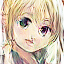

Generated image saved to single_generated_image.png


In [ ]:


random_noise = torch.randn(1, latent_dim, device=device)

generator.eval()
with torch.no_grad():
    generated_image = generator(random_noise).detach().cpu()

generated_image = generated_image * 0.5 + 0.5


generated_image_pil = transforms.ToPILImage()(generated_image.squeeze(0))

print("Generated Image:")
display(generated_image_pil)

generated_image_path = "single_generated_image.png"
generated_image_pil.save(generated_image_path)
print(f"Generated image saved to {generated_image_path}")